# Image vs Text Clustering

In [1]:
import torch
import numpy as np
import pandas as pd
import torch.nn.functional as pyf
import matplotlib.pyplot as graph
from datasets import load_dataset
from transformers import AutoTokenizer, AutoModel, AutoImageProcessor
from sklearn.neighbors import NearestNeighbors
from tqdm.auto import tqdm
from IPython.display import display, Markdown


def get_image_embedding(image: list, preprocessor, model):
    with torch.inference_mode():
        img = preprocessor(images=image, return_tensors="pt")
        embeddings = model(**img)
        embeddings = embeddings['pooler_output']
        embeddings = pyf.normalize(embeddings, p=2, dim=1)
    return embeddings


def get_text_embedding(text: list, tokenizer, text_model):
    def mean_pooling(model_output, attention_mask):
        token_embeddings = model_output[0]  # First element of model_output contains all token embeddings
        input_mask_expanded = attention_mask.unsqueeze(-1).expand(token_embeddings.size()).float()
        return torch.sum(token_embeddings * input_mask_expanded, 1) / torch.clamp(input_mask_expanded.sum(1), min=1e-9)
    
    with torch.inference_mode():
        encoded = tokenizer(text, padding=True, truncation=True, return_tensors='pt')
        output = text_model(**encoded)
        embeddings = mean_pooling(output, encoded['attention_mask'])
        embeddings = pyf.normalize(embeddings, p=2, dim=1)
    return embeddings


image_ds = load_dataset('lambdalabs/pokemon-blip-captions')
display(image_ds)

data = pd.read_csv('data/pokemon-text-descriptions.csv')
display(data.head())

#################################################################################################
# Setup the Embedding Models
#################################################################################################

/home/sar/miniconda3/envs/ai/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


DatasetDict({
    train: Dataset({
        features: ['image', 'text'],
        num_rows: 833
    })
})

,index,response
0,736,1. The creature is primarily white with green ...
1,375,1. The creature is primarily black with some w...
2,679,1. The creature is blue and white.\n2. The cre...
3,588,1. The creature is white.\n2. The creature loo...
4,648,1. The creature is primarily pink with blue sp...


In [2]:
# Text embedding model
base_text_model = 'sentence-transformers/all-mpnet-base-v2'
tokenizer = AutoTokenizer.from_pretrained(base_text_model)
text_model = AutoModel.from_pretrained(base_text_model)

In [3]:
# Image embedding model
base_image_model = 'google/vit-base-patch16-224-in21k'
image_preprocessor = AutoImageProcessor.from_pretrained(base_image_model)
image_model = AutoModel.from_pretrained(base_image_model)

# Generate all Embeddings

In [4]:
text_embeddings = get_text_embedding(data['response'].tolist(), tokenizer, text_model)
data['text_embedding'] = [vec for vec in tqdm(text_embeddings.cpu().detach().numpy())]

print(text_embeddings.shape)
print(text_embeddings)
display(data.head())

100%|██████████| 200/200 [00:00<00:00, 1105218.45it/s]

torch.Size([200, 768])
tensor([[ 0.0028,  0.0284, -0.0263,  ...,  0.0500,  0.0035, -0.0417],
        [ 0.0377, -0.0350, -0.0200,  ...,  0.0423, -0.0192, -0.0115],
        [ 0.0405, -0.0174, -0.0166,  ...,  0.0430,  0.0130, -0.0193],
        ...,
        [ 0.0282, -0.0689, -0.0186,  ...,  0.0571,  0.0166, -0.0016],
        [ 0.0621, -0.0607, -0.0107,  ...,  0.0406, -0.0052, -0.0043],
        [ 0.0786, -0.0341, -0.0041,  ...,  0.0310, -0.0284, -0.0186]])


,index,response,text_embedding
0,736,1. The creature is primarily white with green ...,"[0.0028052432, 0.028414164, -0.026331035, -0.0..."
1,375,1. The creature is primarily black with some w...,"[0.03771795, -0.03500834, -0.020038513, -0.006..."
2,679,1. The creature is blue and white.\n2. The cre...,"[0.04053453, -0.017387154, -0.016586661, -0.00..."
3,588,1. The creature is white.\n2. The creature loo...,"[0.03863281, 0.00018872674, -0.0064324746, 0.0..."
4,648,1. The creature is primarily pink with blue sp...,"[0.06458279, -0.04642107, -0.0091699455, -0.02..."


In [5]:
image_embeddings = get_image_embedding(
    [image_ds['train'][i]['image'] for i in tqdm(data['index'].tolist(), desc='Loading Images')],
    image_preprocessor,
    image_model
)
data['image_embedding'] = [vec for vec in tqdm(image_embeddings.cpu().detach().numpy())]
print(image_embeddings.shape)
print(image_embeddings)
display(data.head())

100%|██████████| 200/200 [00:00<00:00, 1635206.24it/s]

torch.Size([200, 768])
tensor([[ 0.0099,  0.0109, -0.0208,  ...,  0.0357,  0.0578, -0.0301],
        [ 0.0390, -0.0081, -0.0185,  ...,  0.0643,  0.0215, -0.0177],
        [ 0.0411,  0.0437, -0.0373,  ...,  0.0432, -0.0555, -0.0172],
        ...,
        [ 0.0176,  0.0027, -0.0655,  ...,  0.0080,  0.0016,  0.0224],
        [ 0.0443,  0.0144, -0.0724,  ...,  0.0150,  0.0188, -0.0606],
        [ 0.0504,  0.0378, -0.0605,  ...,  0.0553,  0.0564, -0.0182]])


,index,response,text_embedding,image_embedding
0,736,1. The creature is primarily white with green ...,"[0.0028052432, 0.028414164, -0.026331035, -0.0...","[0.009934427, 0.010909692, -0.02078053, 0.0037..."
1,375,1. The creature is primarily black with some w...,"[0.03771795, -0.03500834, -0.020038513, -0.006...","[0.038997088, -0.008112858, -0.018549036, -0.0..."
2,679,1. The creature is blue and white.\n2. The cre...,"[0.04053453, -0.017387154, -0.016586661, -0.00...","[0.041092, 0.043712895, -0.03726576, 0.0120787..."
3,588,1. The creature is white.\n2. The creature loo...,"[0.03863281, 0.00018872674, -0.0064324746, 0.0...","[0.054199975, 0.006271865, -0.059461202, 0.010..."
4,648,1. The creature is primarily pink with blue sp...,"[0.06458279, -0.04642107, -0.0091699455, -0.02...","[-0.024982495, 0.036117654, -0.011171751, -0.0..."


# Display Results

In [6]:
# Get samples
samples = data.sample(50, random_state=42)
display(samples)

# Create embedding models
text_matcher = NearestNeighbors(n_neighbors=5, metric='cosine', n_jobs=-1)
text_matcher.fit(np.vstack(data['text_embedding'].tolist()))
display(text_matcher)

image_matcher = NearestNeighbors(n_neighbors=5, metric='cosine', n_jobs=-1)
image_matcher.fit(np.vstack(data['image_embedding'].tolist()))
display(image_matcher)

# Get the nearest neighbors
text_neighbors = text_matcher.kneighbors(np.vstack(samples['text_embedding'].tolist()), return_distance=False)
image_neighbors = image_matcher.kneighbors(np.vstack(samples['image_embedding'].tolist()), return_distance=False)

,index,response,text_embedding,image_embedding
95,247,1. The creature is blue.\n2. The creature look...,"[0.07584025, -0.056590445, -0.011278735, -0.01...","[0.05658476, 0.0032253384, -0.012650413, 0.037..."
15,759,1. The creature is primarily blue with pink an...,"[0.052846614, -0.049554475, -0.020344783, -0.0...","[0.04611234, -0.02122795, -0.020792132, 0.0048..."
30,64,1. The creature is primarily white with some p...,"[0.0507729, 0.036941923, -0.023878315, -0.0020...","[0.02835742, 0.027718283, -0.054491624, -0.024..."
158,272,1. The creature is primarily blue with yellow ...,"[0.06106254, -0.049227163, -0.03451397, -0.032...","[0.032026753, -0.018974096, -0.041813295, 0.03..."
128,620,1. The creature is blue.\n2. The creature look...,"[0.045809083, -0.04531418, -0.011012132, 0.020...","[0.0425232, -0.010245859, -0.032216158, 0.0544..."
115,262,1. The creature is blue.\n2. The creature look...,"[0.016560584, -0.059520975, -0.024860986, -0.0...","[0.033713214, -0.0047400245, -0.071077086, 0.0..."
69,50,1. The creature is brown.\n2. The creature loo...,"[0.06764519, -0.0678931, -0.0024884364, 0.0085...","[0.034506094, -0.0073882933, -0.044127505, 0.0..."
170,237,1. The creature is primarily brown with some y...,"[0.045097988, -0.011127147, -0.030613001, -0.0...","[0.010247741, 0.002441317, -0.02601155, 0.0066..."
174,368,1. The creature is orange.\n2. The creature lo...,"[0.07285369, -0.050231423, 0.002102609, 0.0040...","[0.025031624, 0.02609014, -0.060032297, 0.0050..."
45,280,1. The creature is pink.\n2. The creature look...,"[0.05208106, -0.075353734, -0.016159952, 0.001...","[0.018461712, 0.038766224, -0.05714132, 0.0285..."


NearestNeighbors(metric='cosine', n_jobs=-1)

NearestNeighbors(metric='cosine', n_jobs=-1)

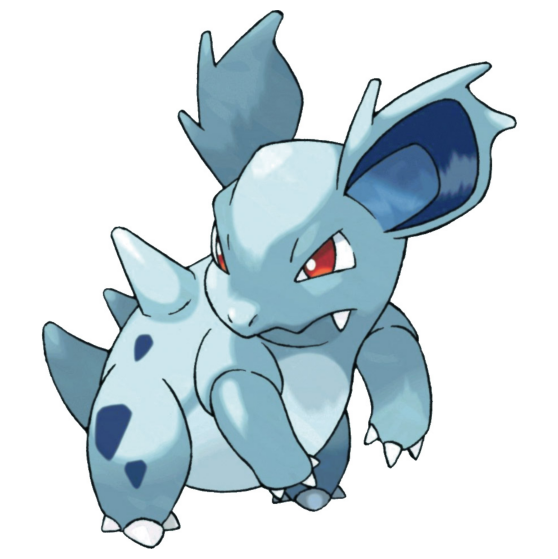

1. The creature is blue.
2. The creature looks unfriendly due to its intense red eyes and the way its mouth is open, suggesting it might be growling or hissing.

### Matched by generated text

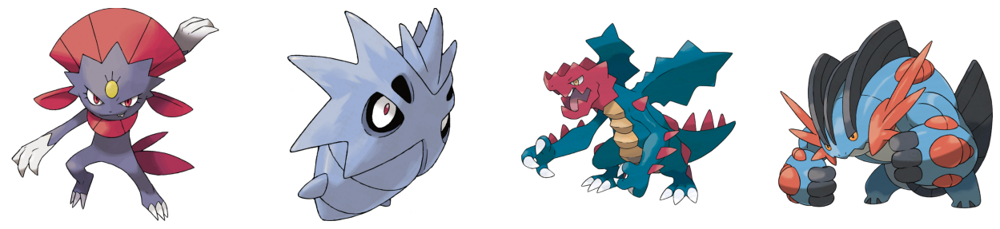

### Matched by raw image

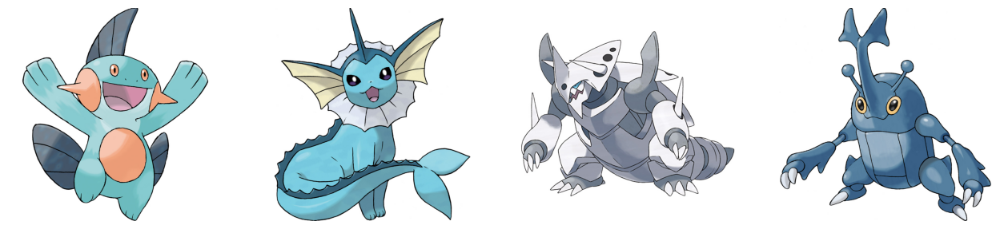

---

---

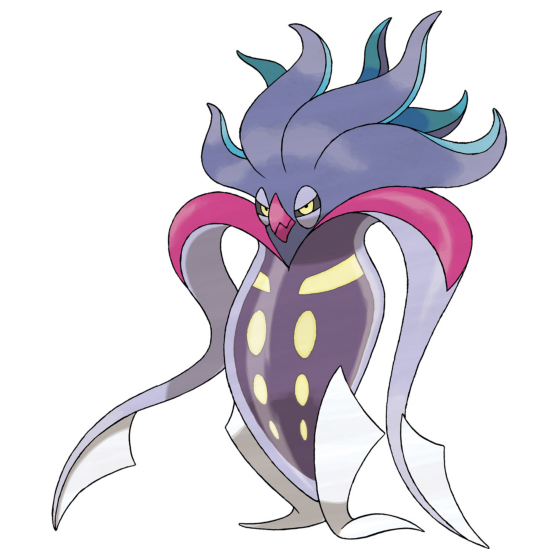

1. The creature is primarily blue with pink and yellow accents.
2. The creature has a somewhat unfriendly appearance due to its sharp teeth and the intense look in its eyes.

### Matched by generated text

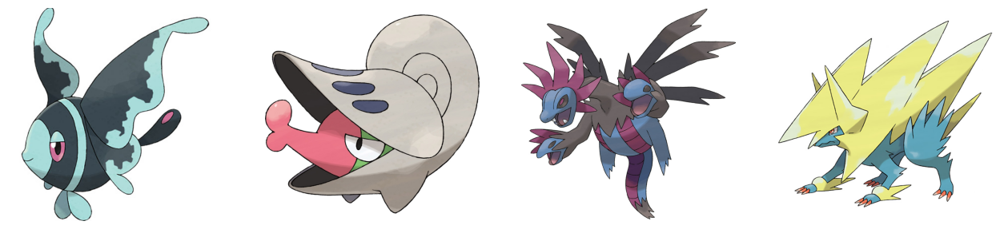

### Matched by raw image

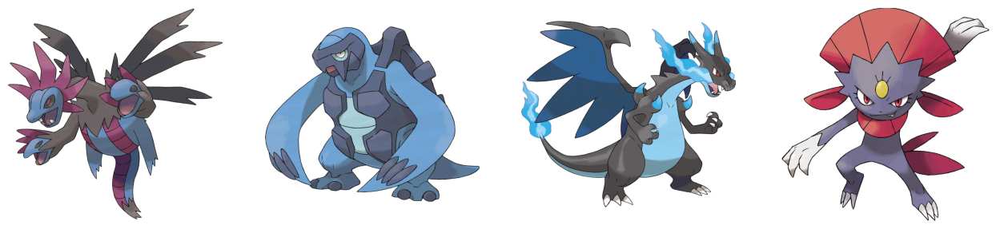

---

---

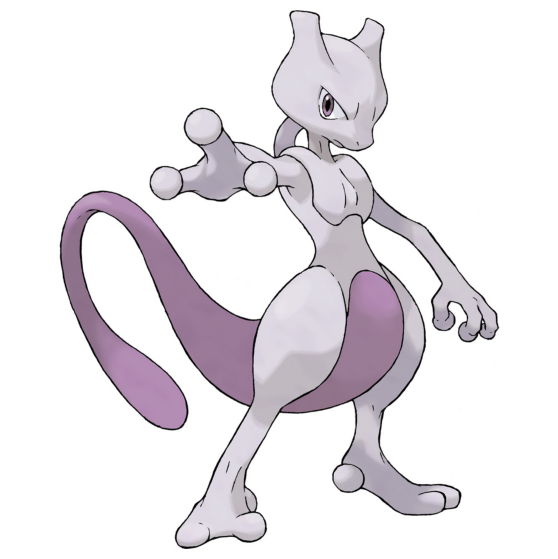

1. The creature is primarily white with some purple accents.
2. The creature looks unfriendly due to its intense stare and the way it is positioned with its arms outstretched, possibly in a defensive or aggressive posture.

### Matched by generated text

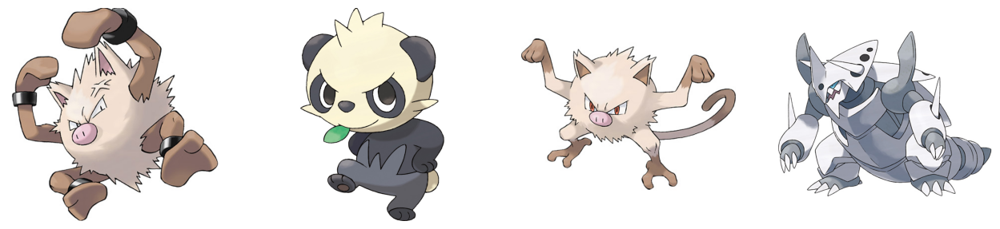

### Matched by raw image

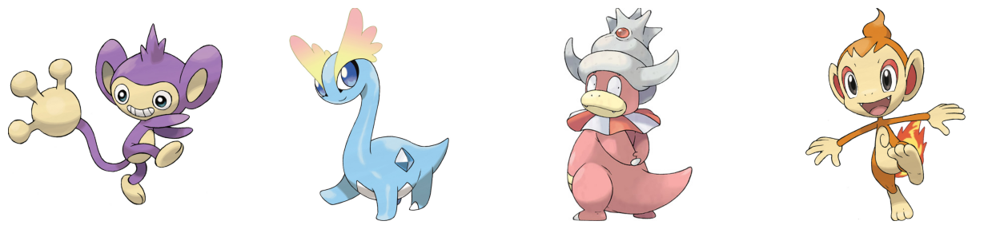

---

---

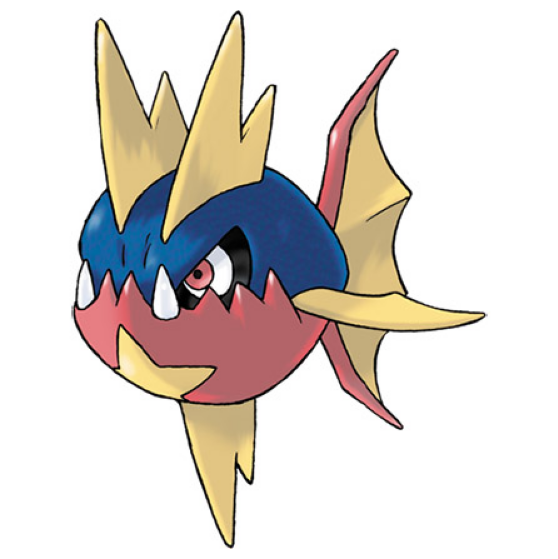

1. The creature is primarily blue with yellow fins and a pink body.
2. The creature looks unfriendly due to its large, sharp teeth and the angry expression on its face.

### Matched by generated text

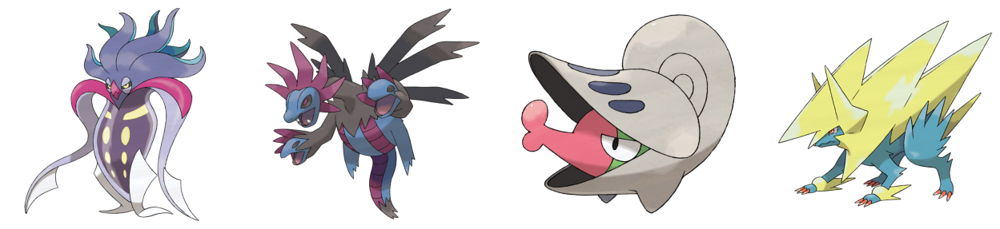

### Matched by raw image

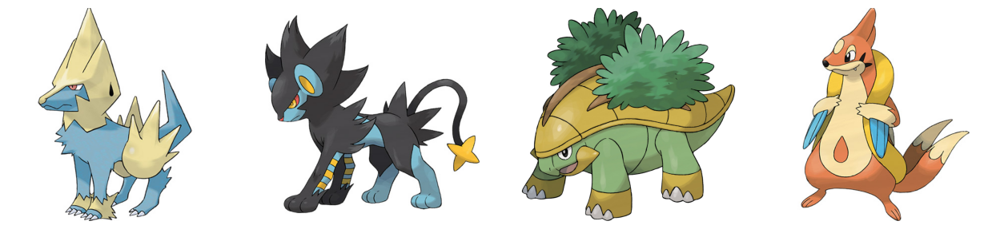

---

---

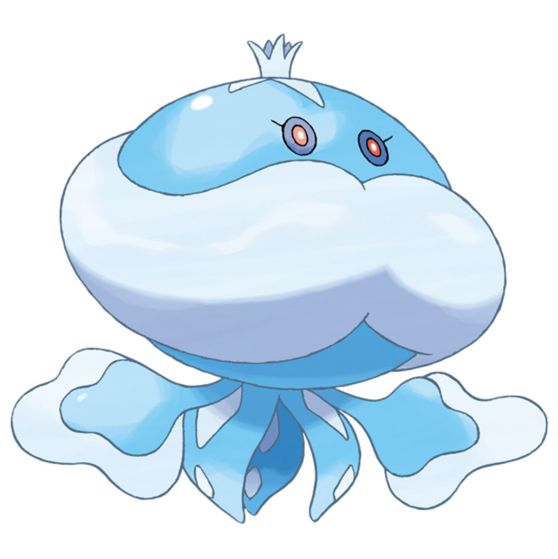

1. The creature is blue.
2. The creature looks friendly. It has a big smile and a crown, which suggests it is royal and might be kind.

### Matched by generated text

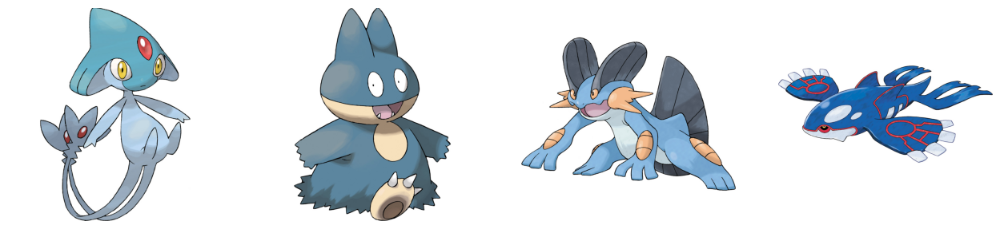

### Matched by raw image

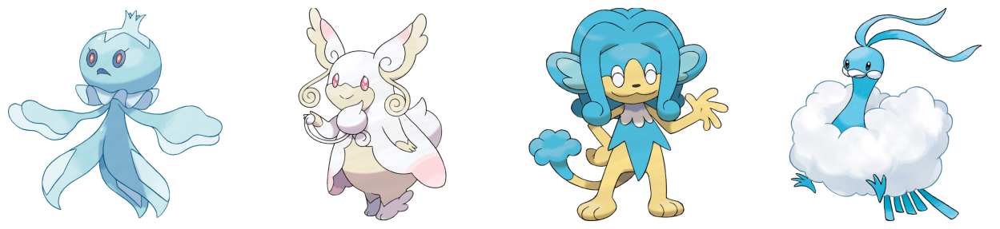

---

---

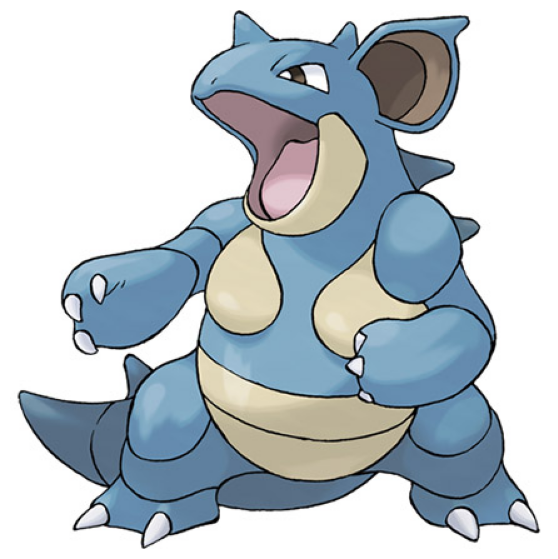

1. The creature is blue.
2. The creature looks friendly. It has a wide open mouth, which is often associated with a smile or a sign of friendliness in many cultures. Additionally, the creature's body language, with its arms outstretched and its posture relaxed, suggests a welcoming and non-threatening demeanor.

### Matched by generated text

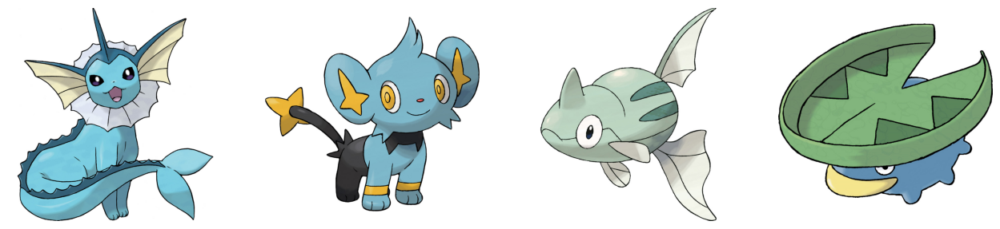

### Matched by raw image

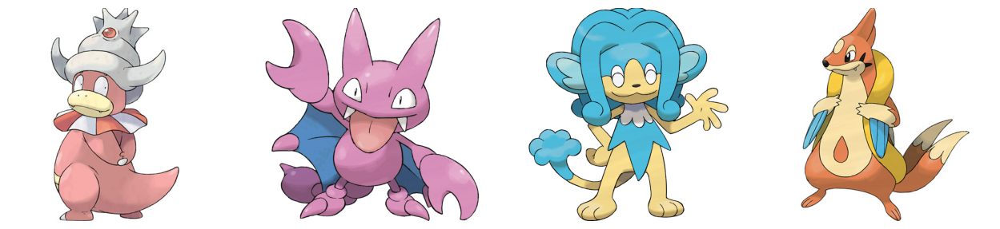

---

---

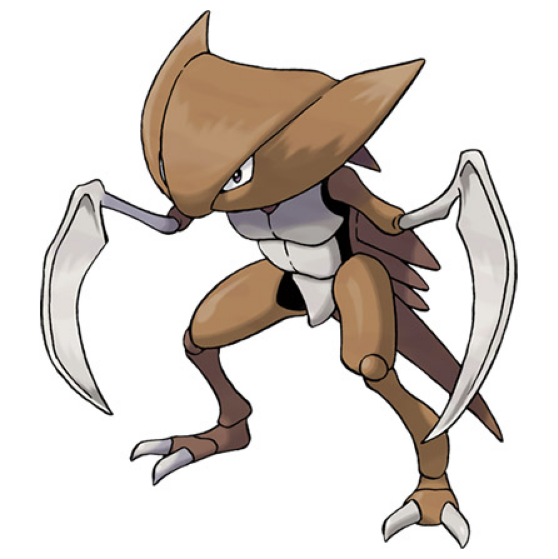

1. The creature is brown.
2. The creature looks unfriendly due to its sharp claws and the way it is positioned, ready to attack.

### Matched by generated text

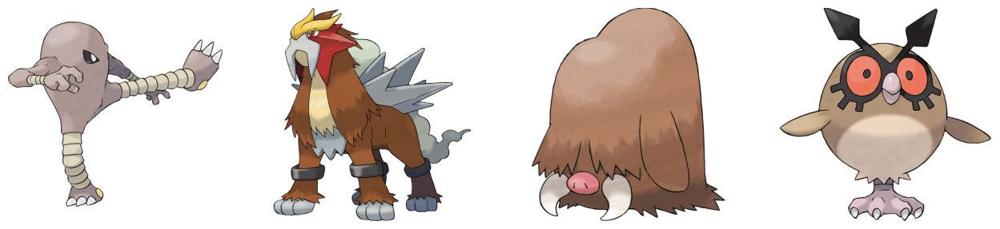

### Matched by raw image

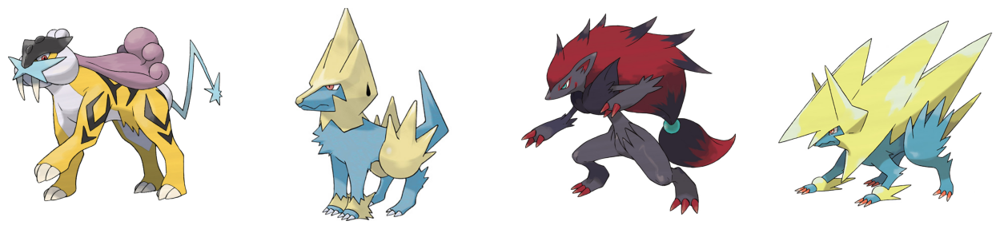

---

---

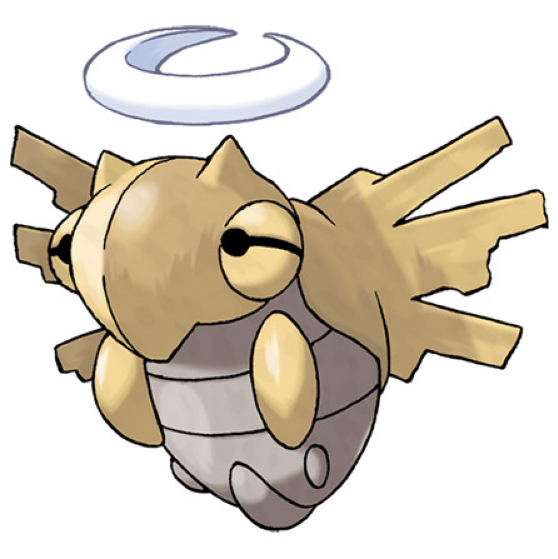

1. The creature is primarily brown with some yellow and white accents.
2. The creature has a friendly expression with its big eyes and the way it's smiling.

### Matched by generated text

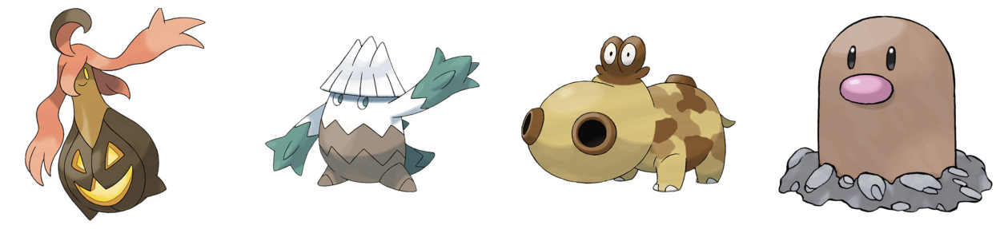

### Matched by raw image

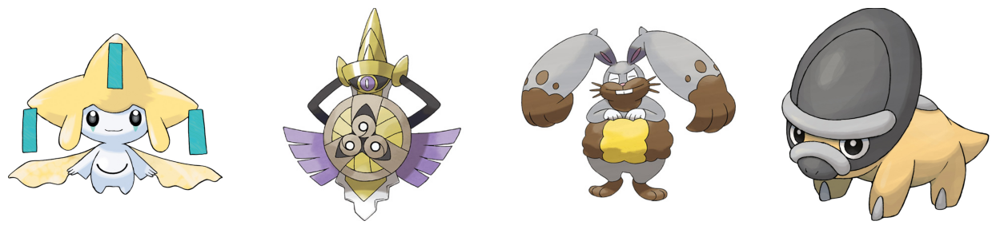

---

---

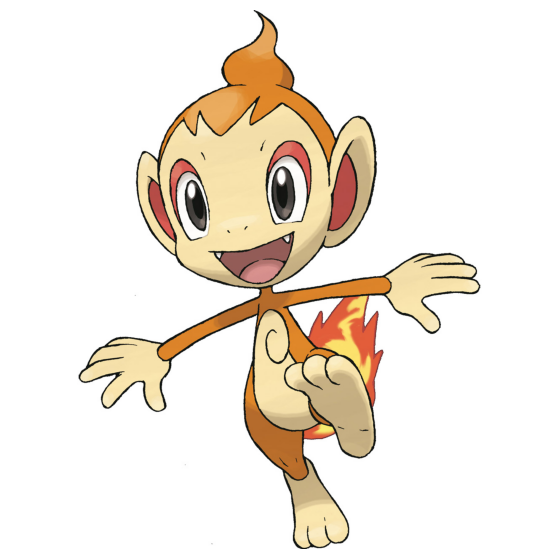

1. The creature is orange.
2. The creature looks friendly. It has a big smile and its arms are outstretched, which can be seen as a welcoming gesture.

### Matched by generated text

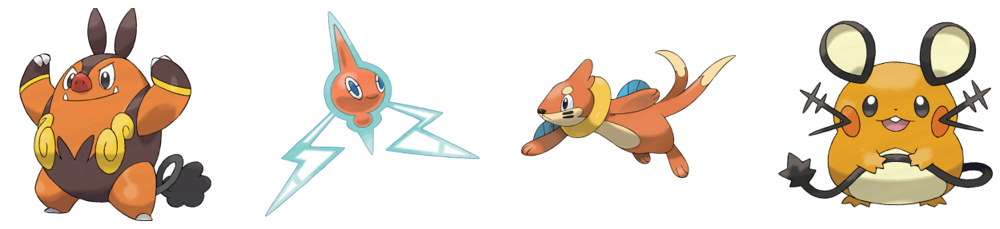

### Matched by raw image

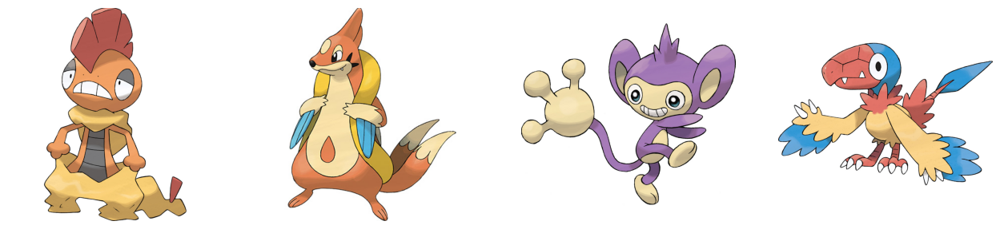

---

---

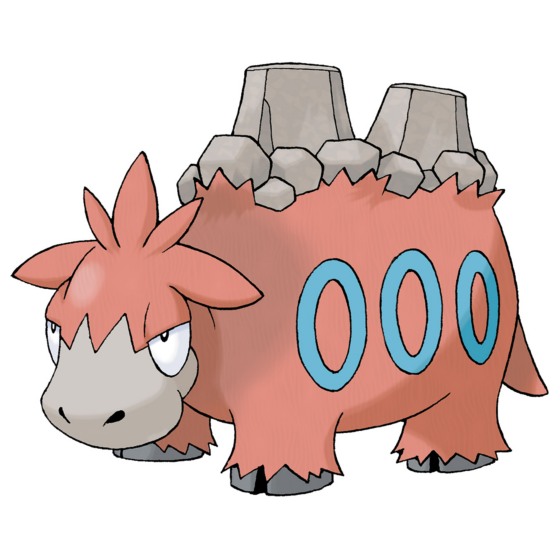

1. The creature is pink.
2. The creature looks unfriendly due to its large, sharp horns and the aggressive stance it is portrayed with.

### Matched by generated text

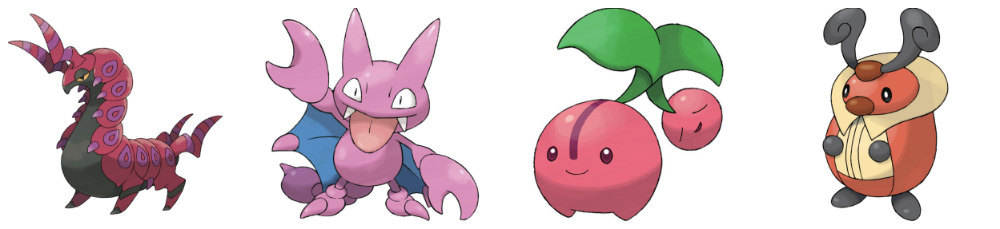

### Matched by raw image

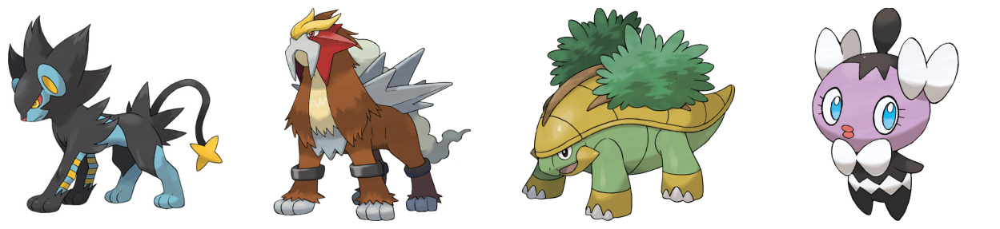

---

---

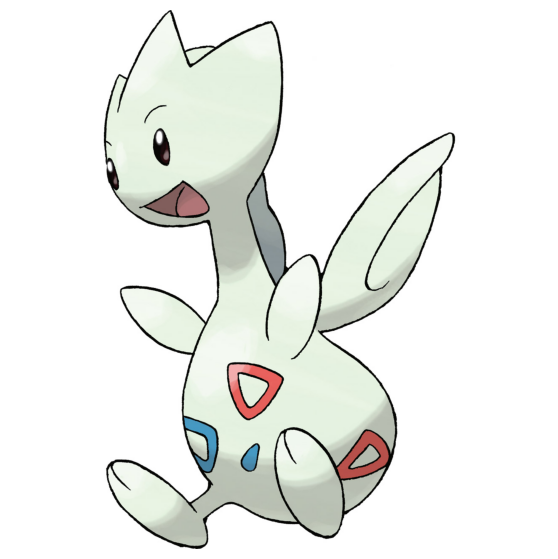

1. The creature is white with red, blue, and yellow accents.
2. The creature looks friendly, with a wide smile and a relaxed posture.

### Matched by generated text

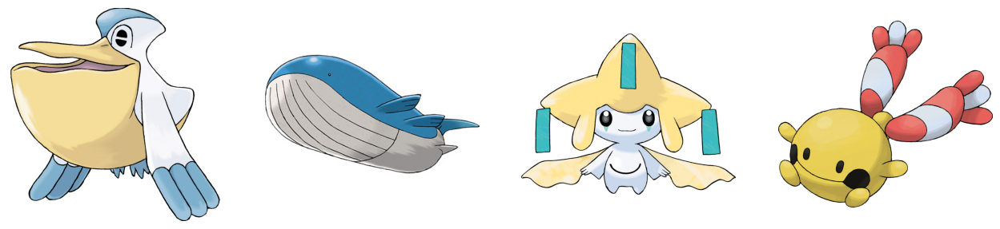

### Matched by raw image

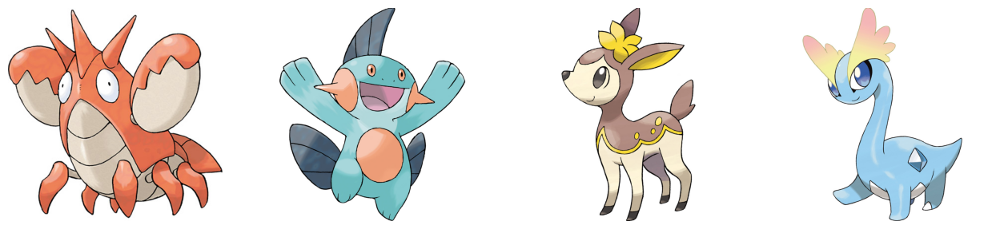

---

---

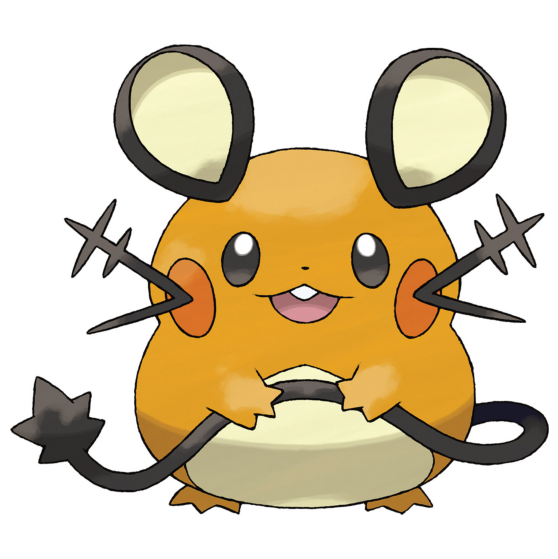

1. The creature is orange.
2. The creature looks friendly. It has a big smile and its ears are perked up, which are signs of happiness and friendliness in many animals.

### Matched by generated text

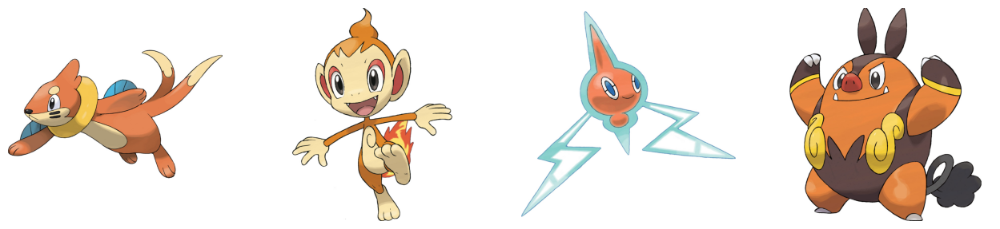

### Matched by raw image

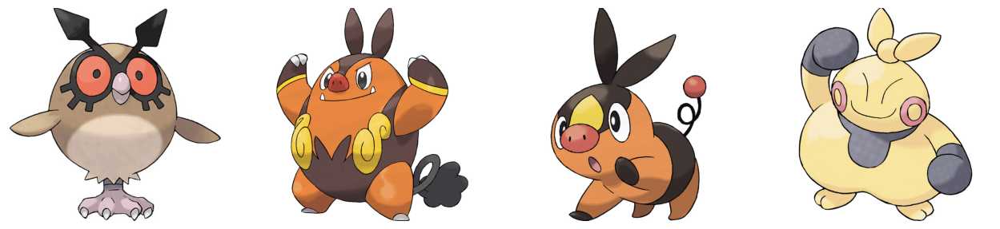

---

---

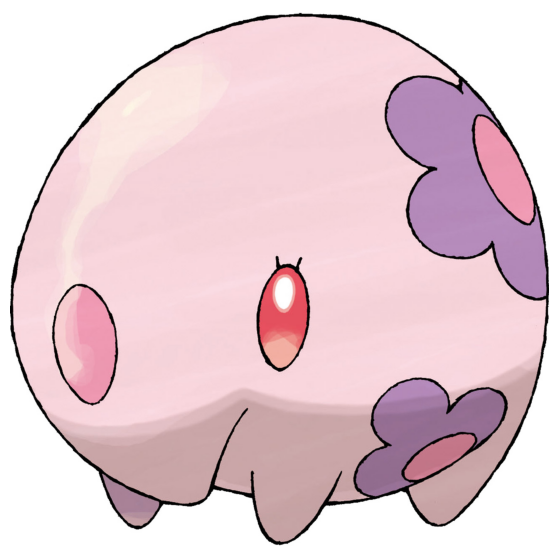

1. The creature is pink.
2. The creature looks friendly. It has a big, round body with a smiling face and a big, round eye. The overall shape and appearance of the creature is cute and inviting.

### Matched by generated text

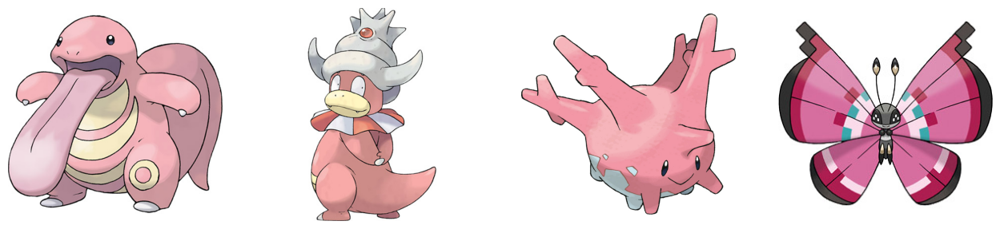

### Matched by raw image

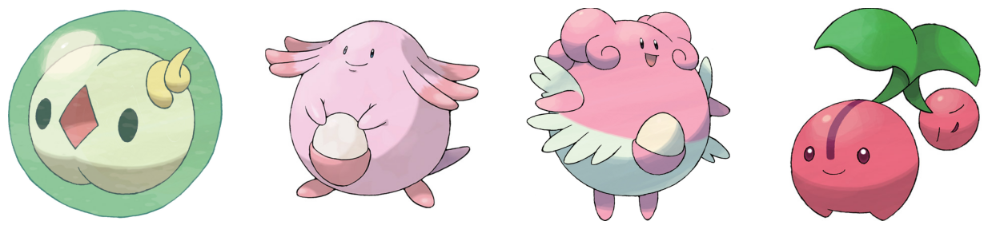

---

---

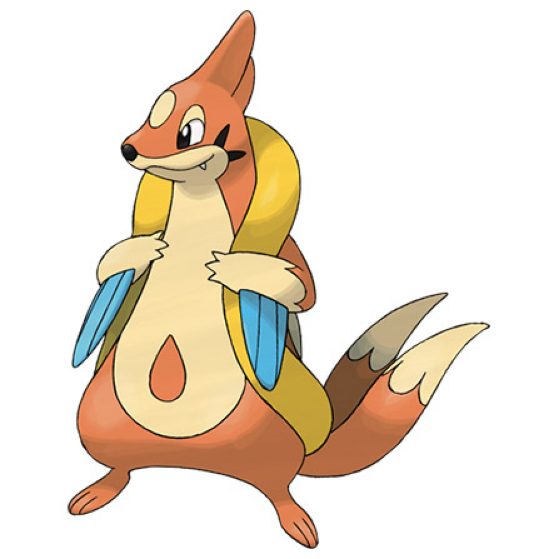

1. The creature is orange and yellow with blue wings.
2. The creature looks friendly, with a big smile and a relaxed posture.

### Matched by generated text

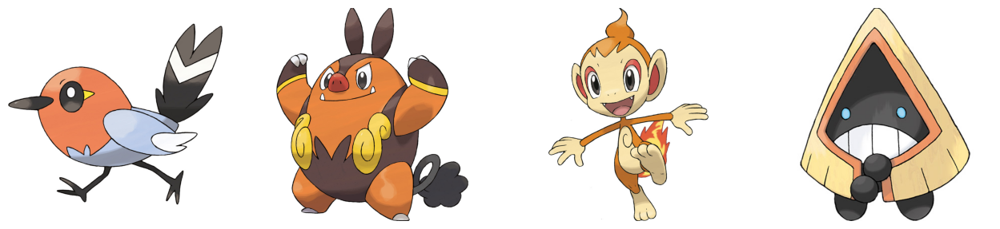

### Matched by raw image

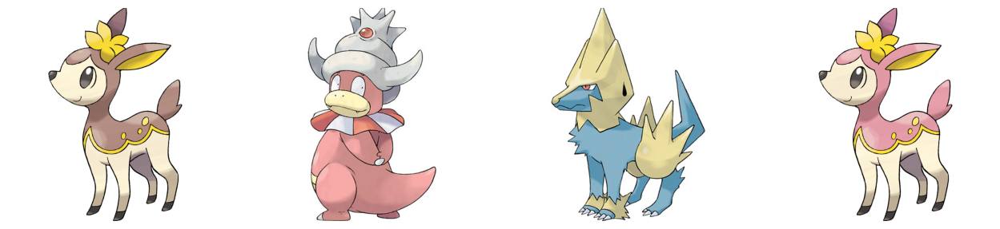

---

---

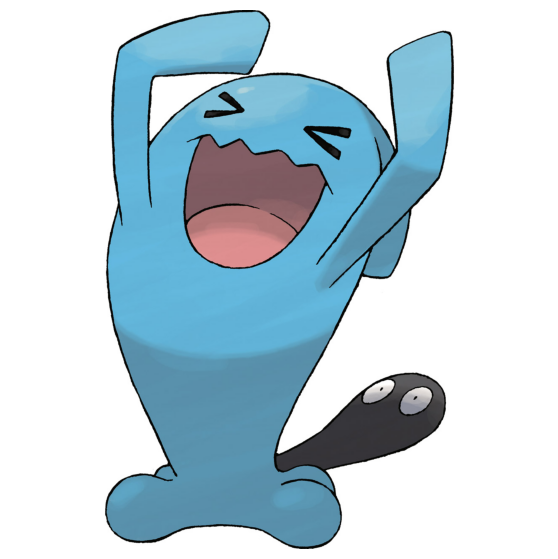

1. The creature is blue.
2. The creature looks friendly. It has a big smile and its arms are raised in a welcoming gesture.

### Matched by generated text

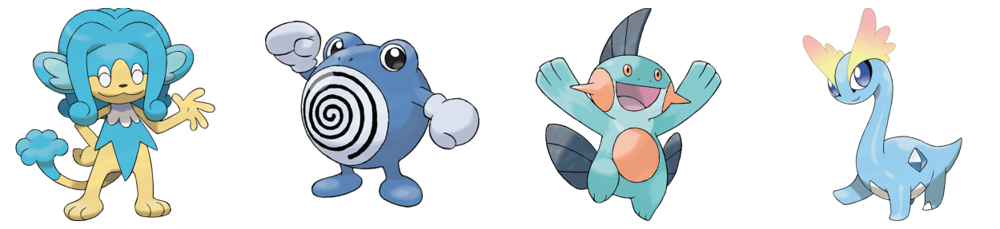

### Matched by raw image

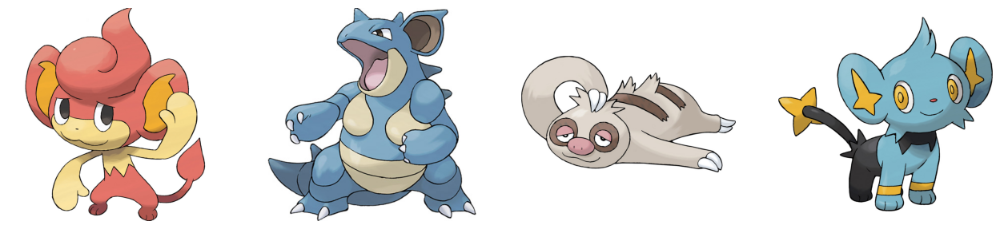

---

---

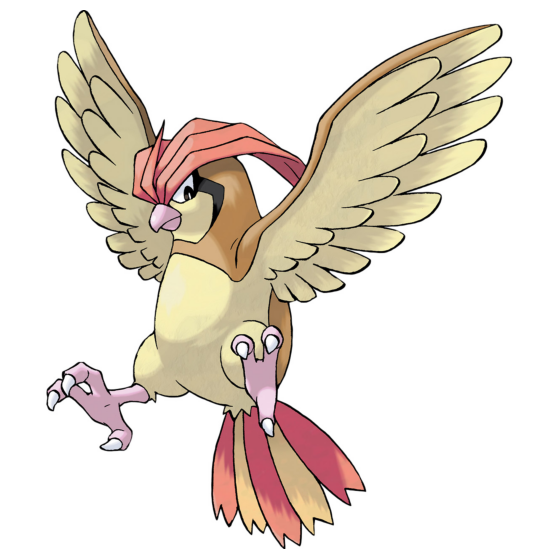

1. The creature is primarily yellow with red and pink accents.
2. The creature looks unfriendly due to its sharp beak and intense gaze.

### Matched by generated text

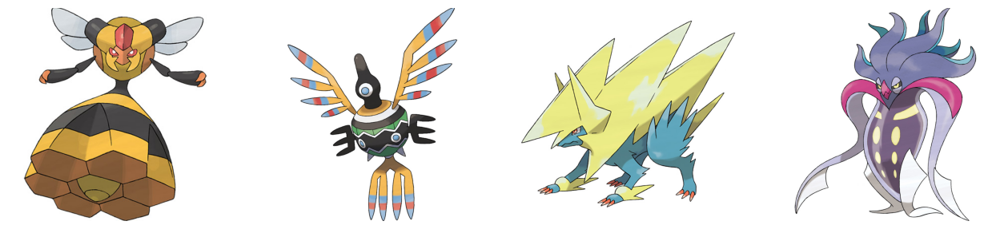

### Matched by raw image

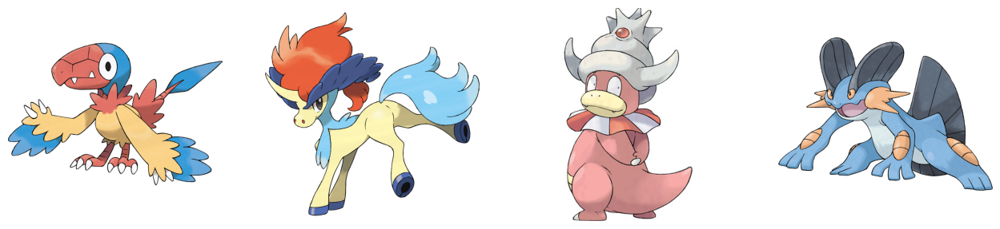

---

---

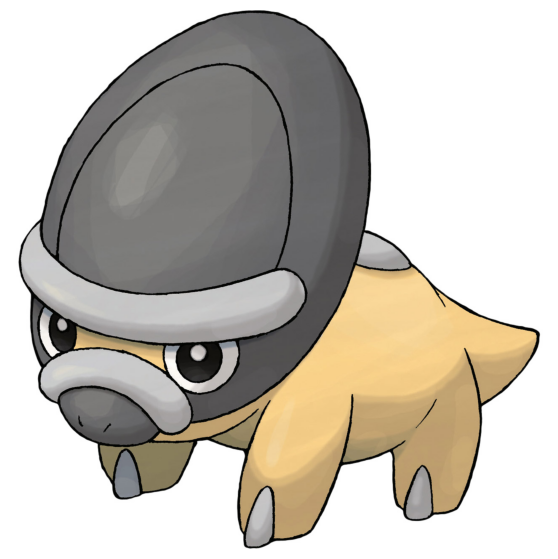

1. The creature is primarily yellow with some grey and black accents.
2. The creature has a neutral expression and does not appear to be overtly friendly or unfriendly. Its facial features are simple and not overly expressive, which could suggest a calm or neutral demeanor.

### Matched by generated text

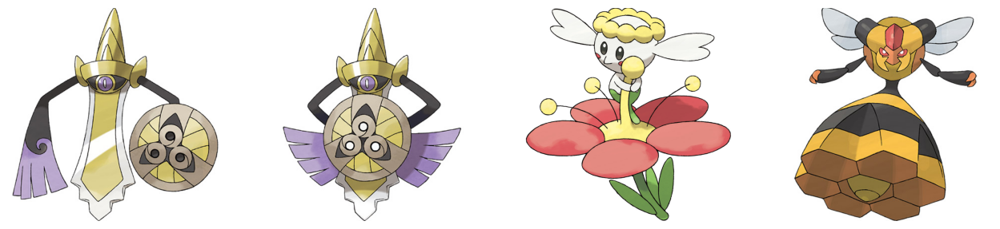

### Matched by raw image

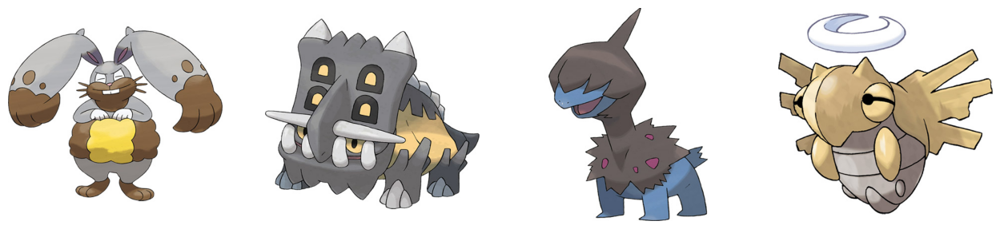

---

---

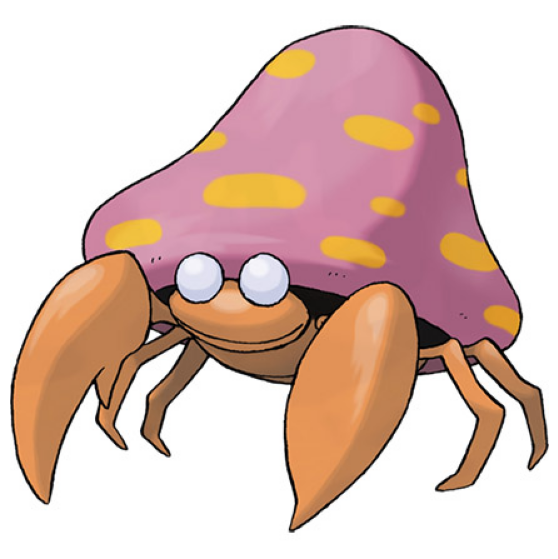

1. The creature is purple with yellow spots.
2. The creature looks friendly, as it has a smiling expression and is wearing a cute hat.

### Matched by generated text

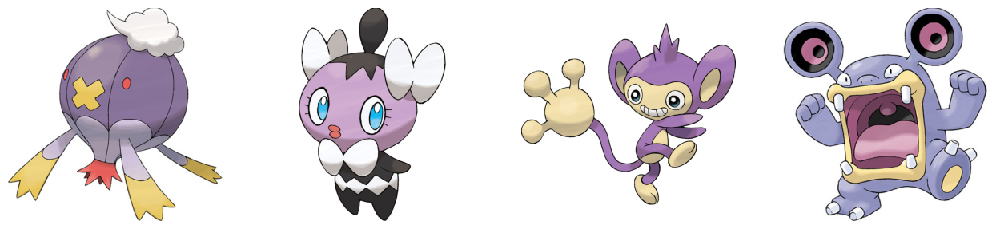

### Matched by raw image

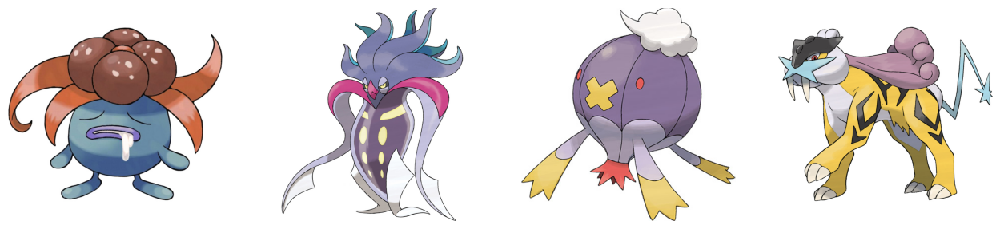

---

---

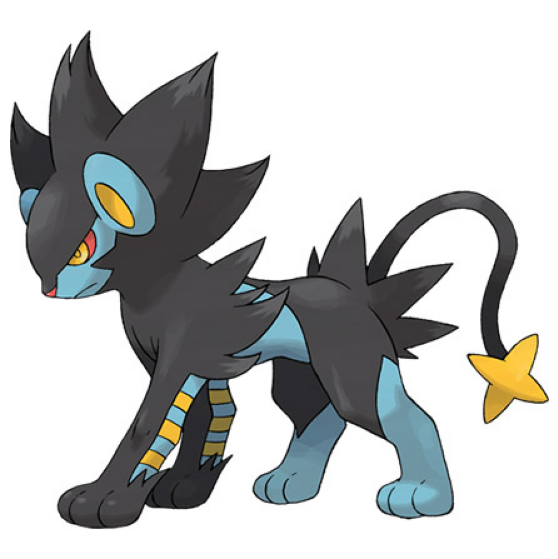

1. The creature is black and blue.
2. The creature looks unfriendly due to its sharp teeth and piercing eyes, which are often associated with predators or creatures that are dangerous to humans.

### Matched by generated text

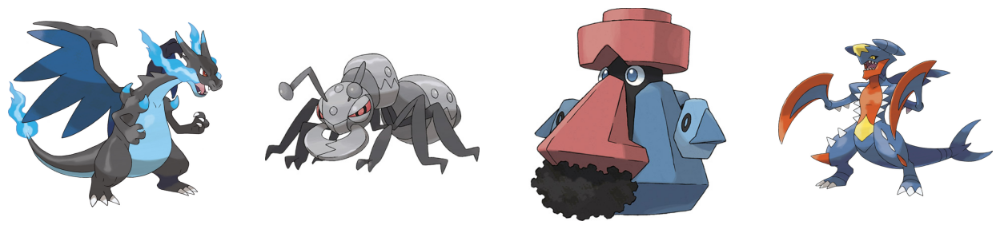

### Matched by raw image

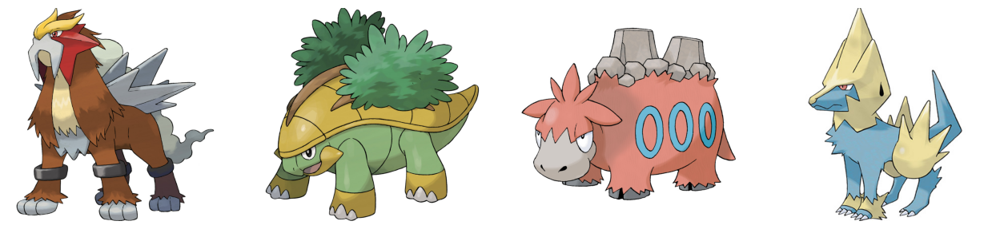

---

---

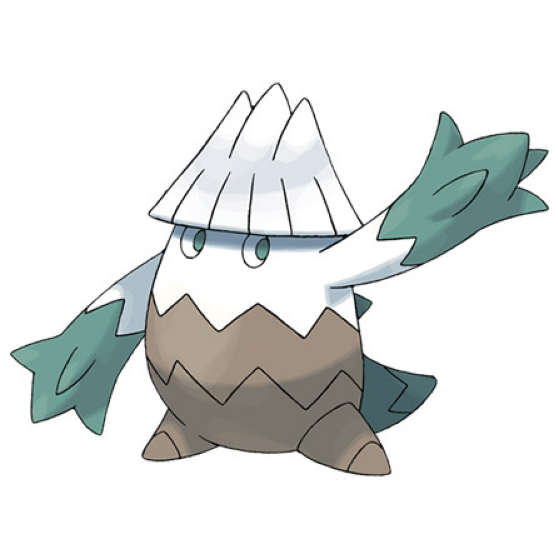

1. The creature is brown and white.
2. The creature looks friendly. It has a big smile and its body language suggests it is welcoming and approachable.

### Matched by generated text

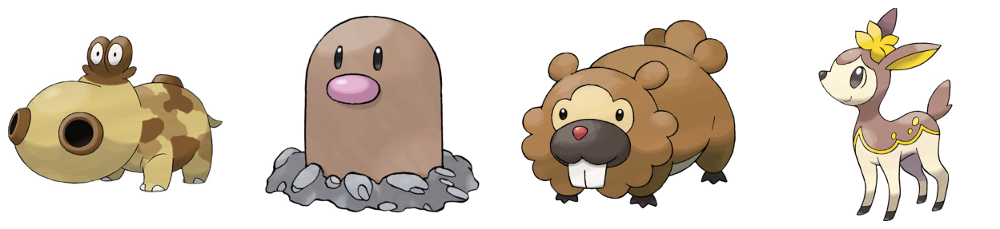

### Matched by raw image

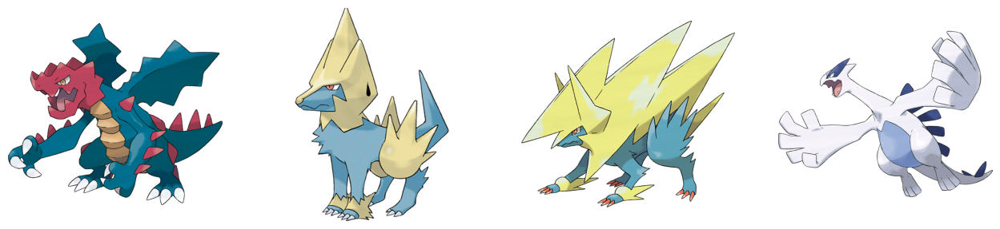

---

---

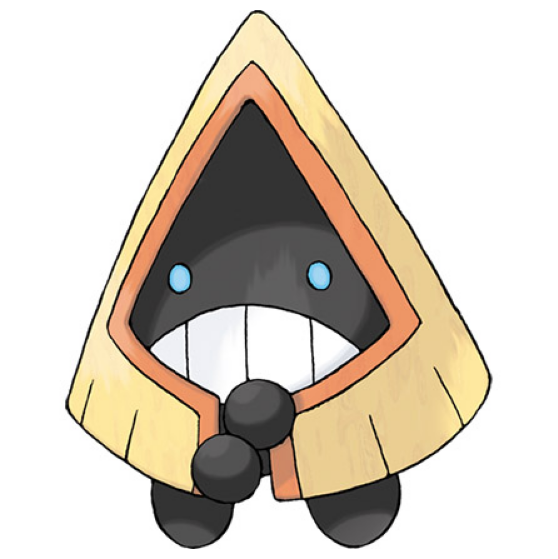

1. The creature is primarily orange with some black accents.
2. The creature has a friendly expression with a wide smile and blue eyes, which suggests it is approachable and possibly curious or playful.

### Matched by generated text

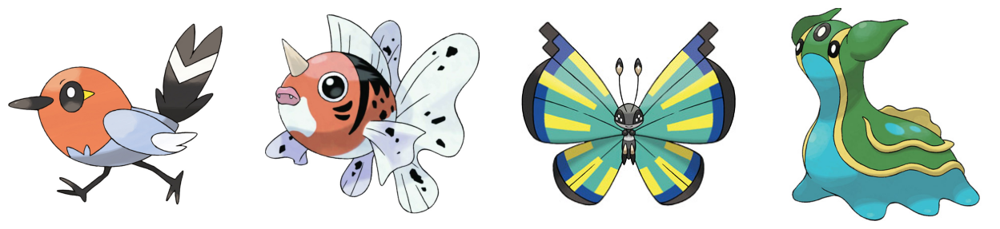

### Matched by raw image

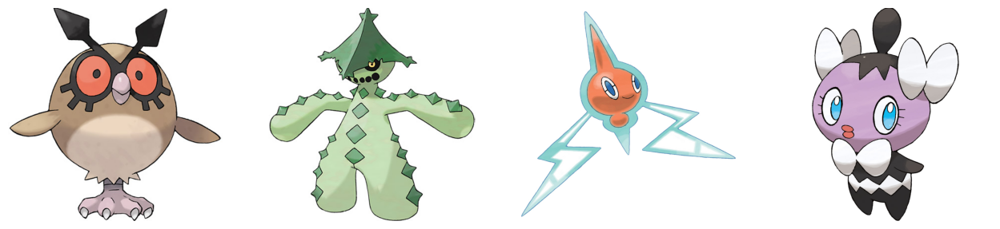

---

---

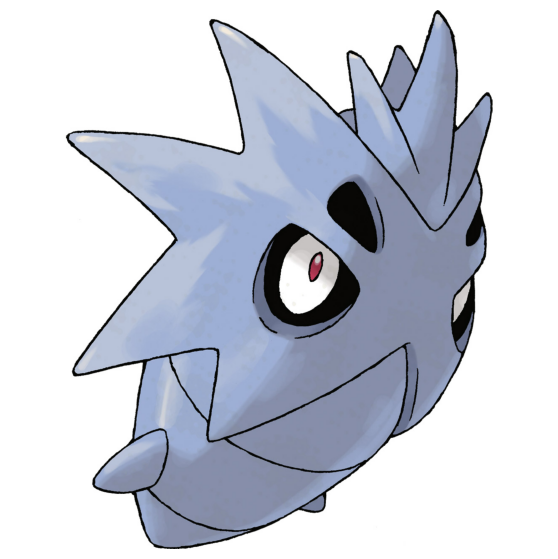

1. The creature is blue.
2. The creature looks unfriendly due to its large, dark eyes and the way its mouth is open in a way that suggests it might be screaming or making a sound.

### Matched by generated text

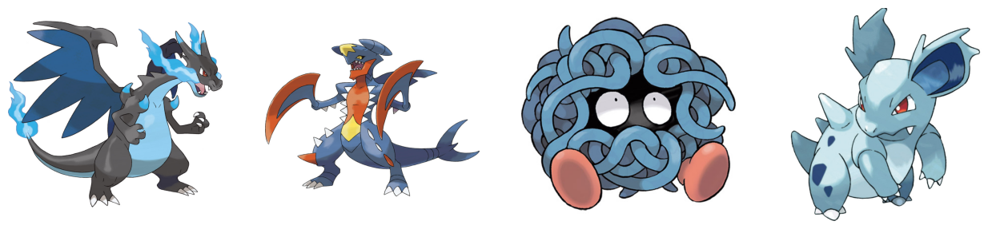

### Matched by raw image

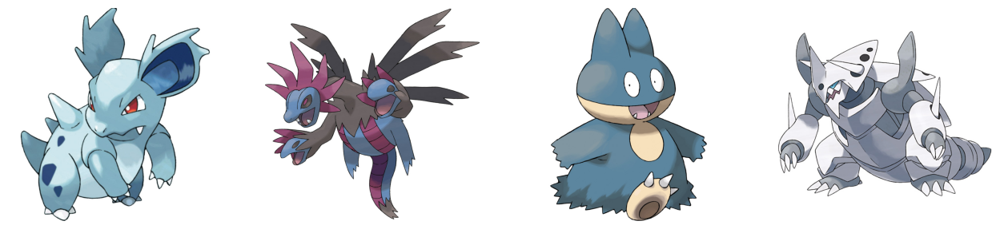

---

---

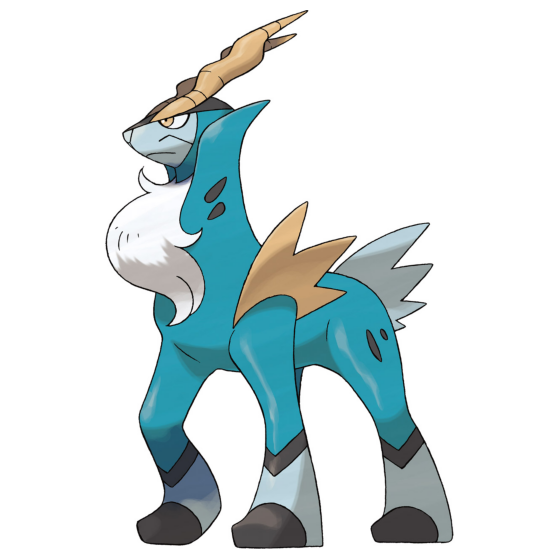

1. The creature is blue.
2. The creature looks unfriendly. It has a stern expression and its body language is stiff and upright, which can be interpreted as defensive or aggressive.

### Matched by generated text

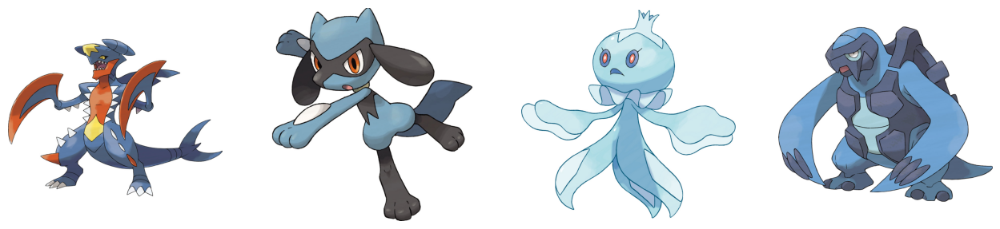

### Matched by raw image

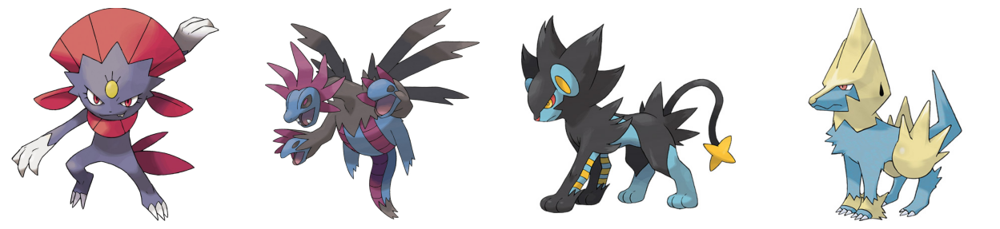

---

---

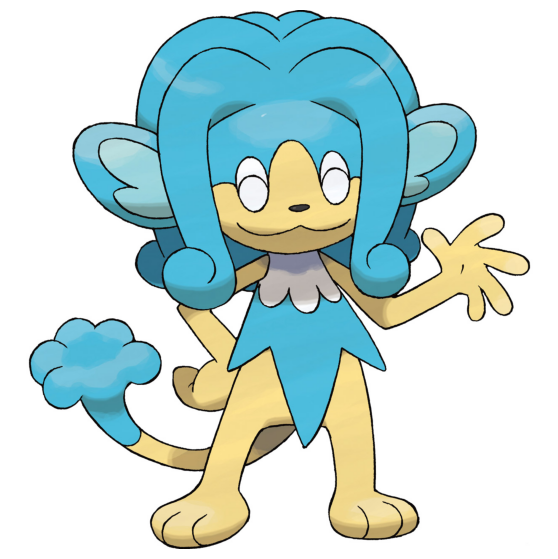

1. The creature is blue.
2. The creature looks friendly. It has a big smile and its arms are outstretched in a welcoming gesture.

### Matched by generated text

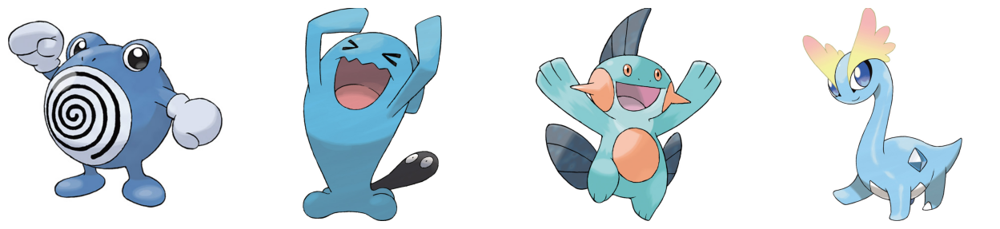

### Matched by raw image

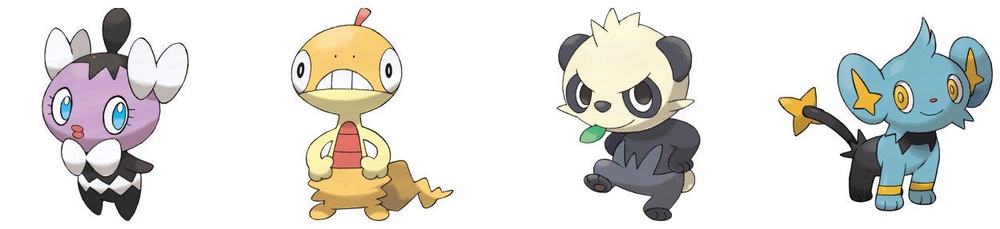

---

---

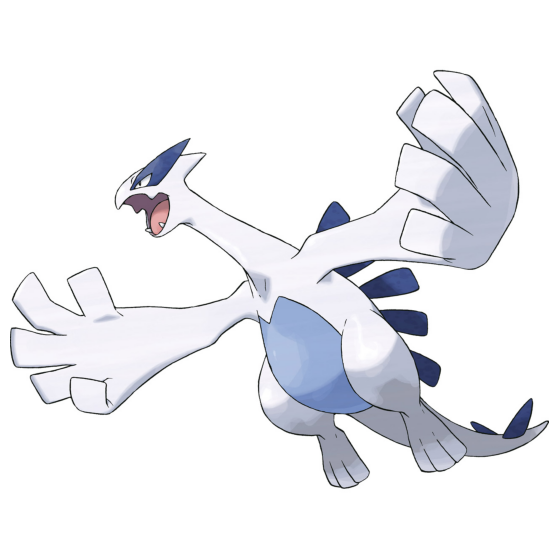

1. The creature is primarily white with blue accents.
2. The creature looks friendly, as it has a wide-open beak and a relaxed posture, suggesting it is not threatened or aggressive.

### Matched by generated text

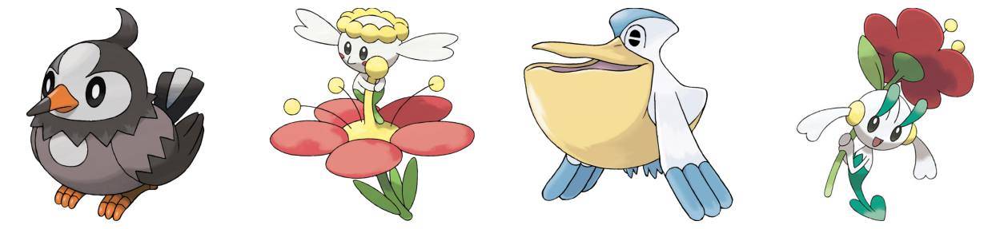

### Matched by raw image

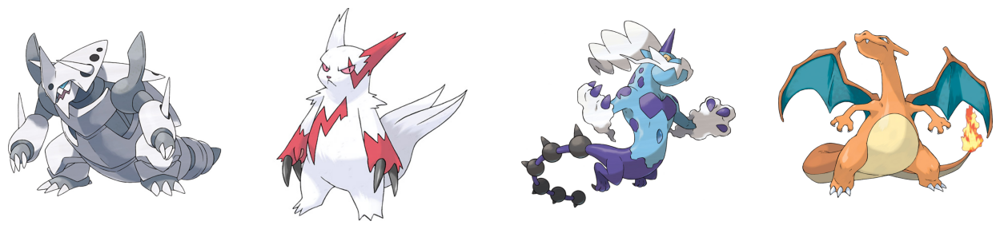

---

---

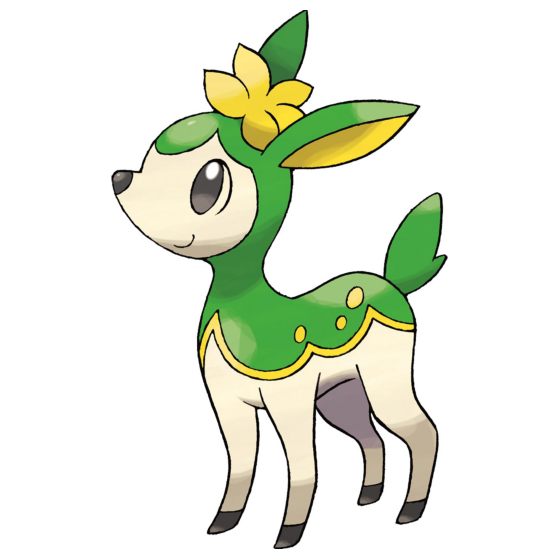

1. The creature is green and white.
2. The creature looks friendly. It has a big smile and its ears are perked up, which often indicates that an animal is happy or alert.

### Matched by generated text

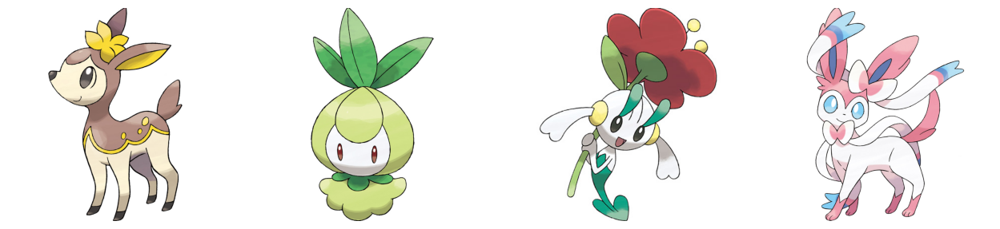

### Matched by raw image

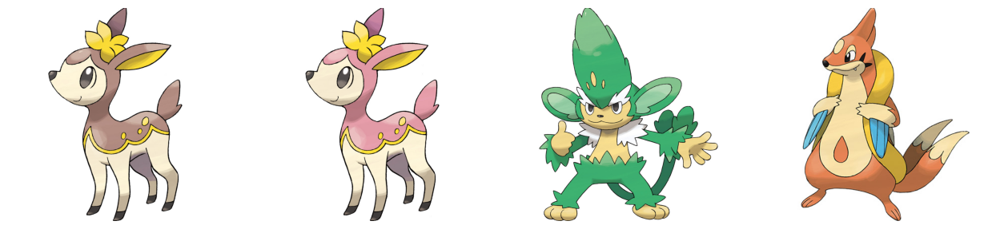

---

---

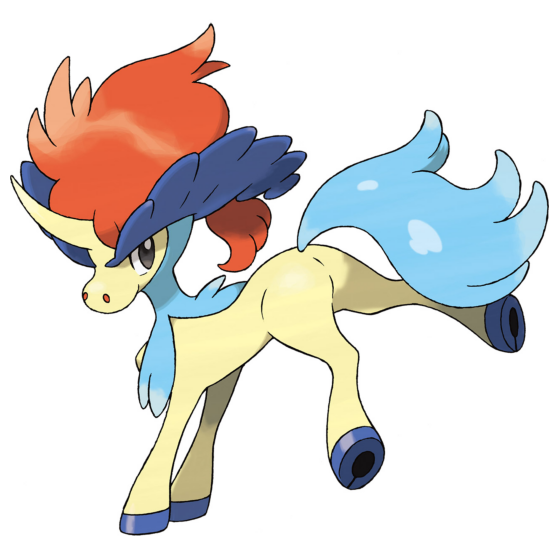

1. The creature is blue and yellow with red accents.
2. The creature looks friendly, with a gentle expression and a posture that suggests it is ready to engage with others.

### Matched by generated text

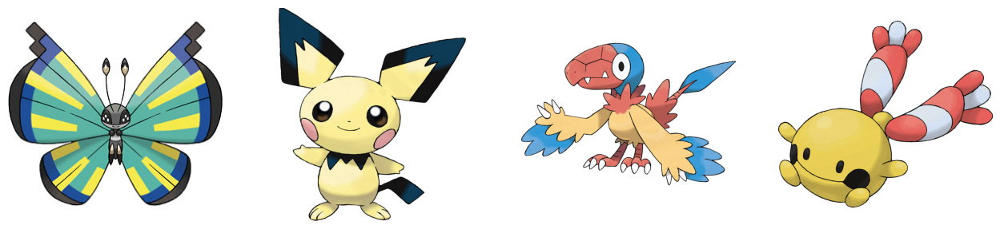

### Matched by raw image

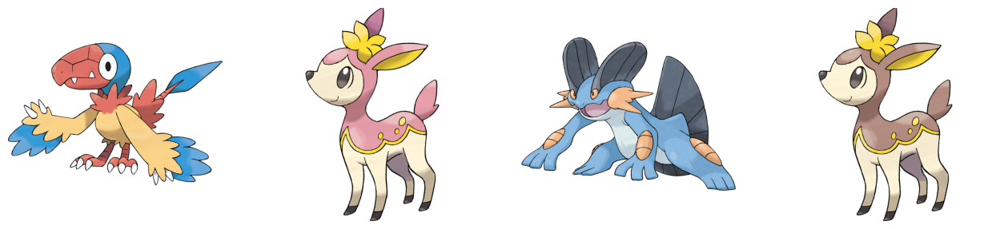

---

---

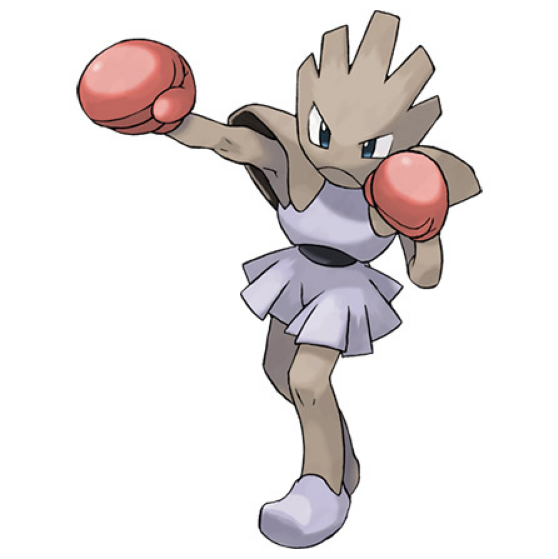

1. The creature is purple.
2. The creature looks friendly. It has a smiling expression and is wearing boxing gloves, which suggests a playful or sporty demeanor.

### Matched by generated text

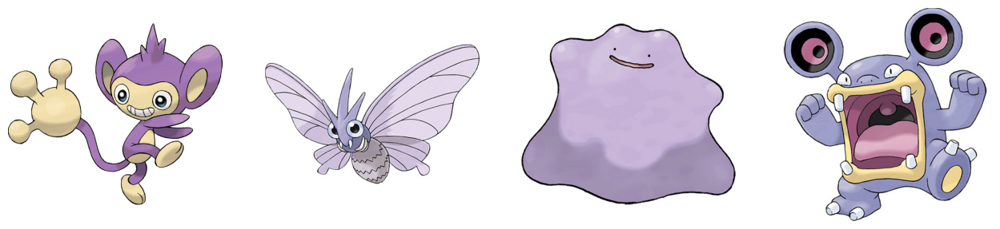

### Matched by raw image

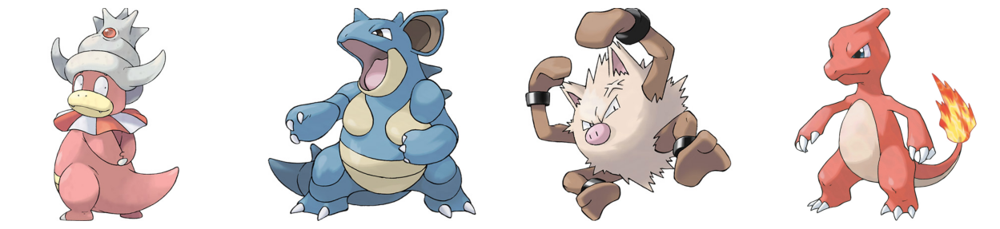

---

---

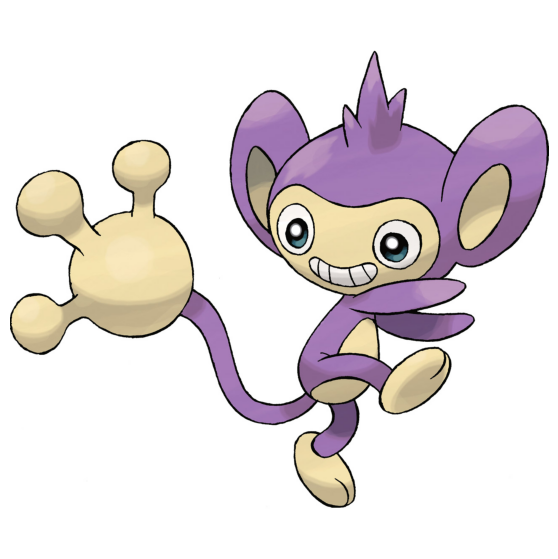

1. The creature is purple.
2. The creature looks friendly. It has a big smile and its body language suggests it is in a playful or joyful mood.

### Matched by generated text

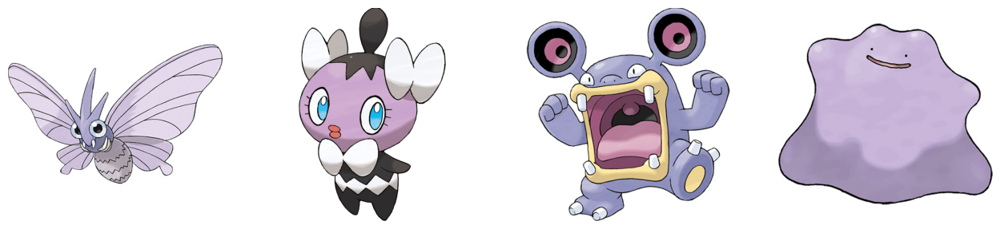

### Matched by raw image

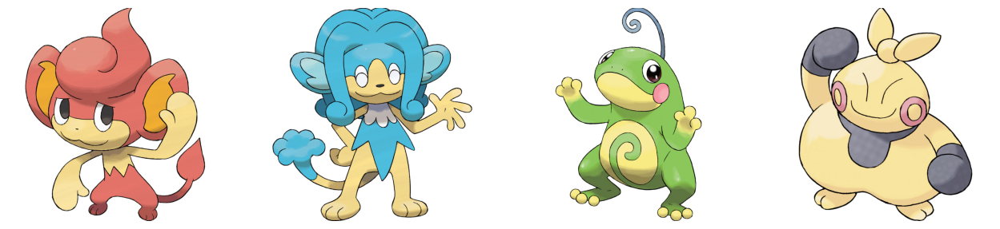

---

---

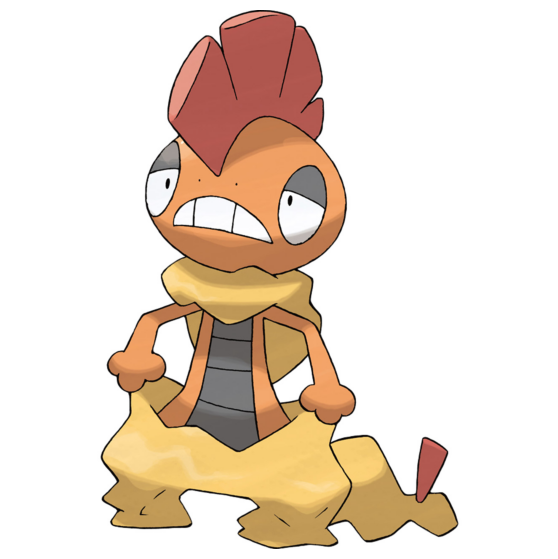

1. The creature is orange with some red and yellow accents.
2. The creature looks unfriendly due to its wide-eyed expression and open mouth, which can be interpreted as a scream or a shout.

### Matched by generated text

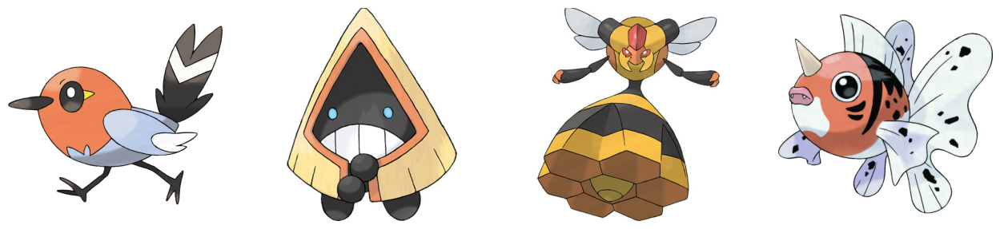

### Matched by raw image

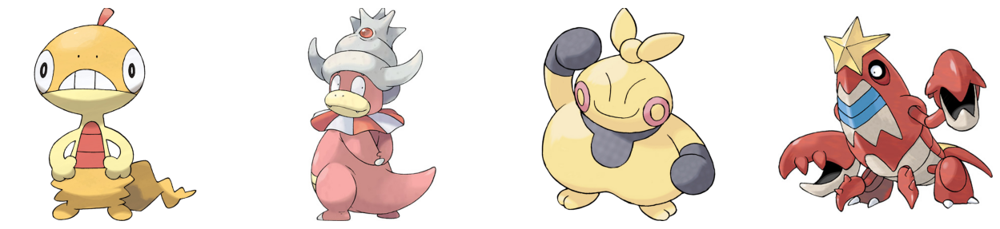

---

---

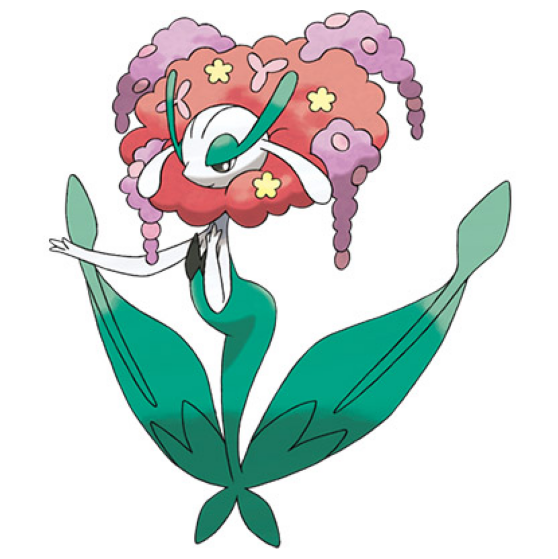

1. The creature is primarily green with pink and purple accents.
2. The creature has a friendly appearance, with a gentle smile and a welcoming pose.

### Matched by generated text

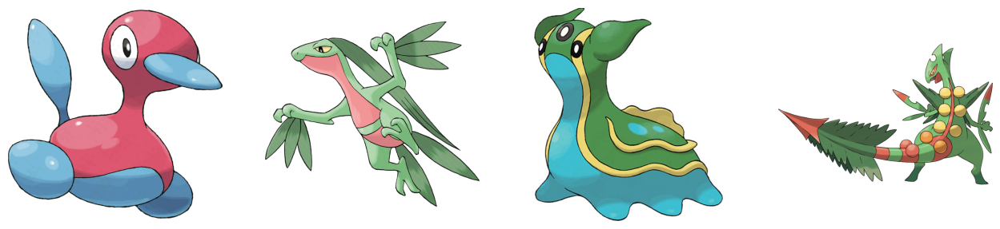

### Matched by raw image

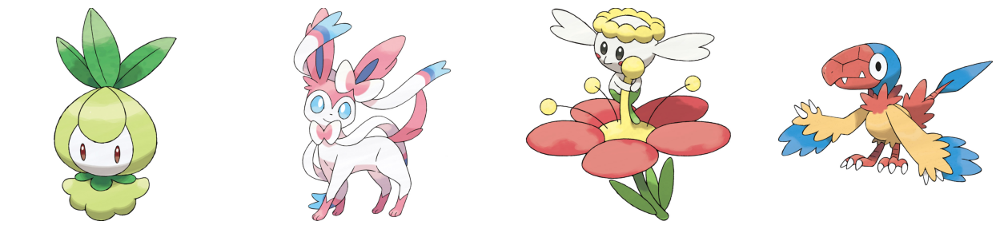

---

---

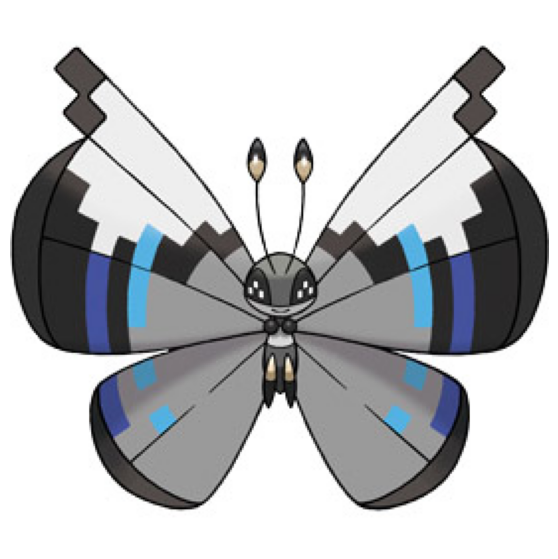

1. The creature is primarily black and white with some blue accents.
2. The creature has a neutral expression and does not appear to be overtly friendly or unfriendly.

### Matched by generated text

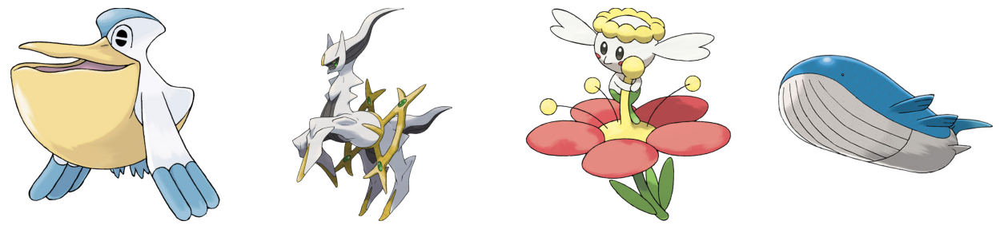

### Matched by raw image

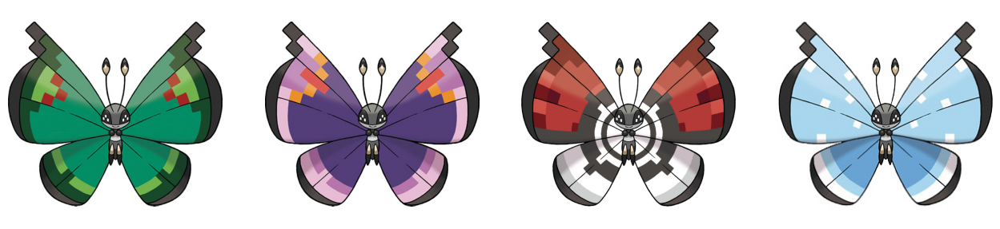

---

---

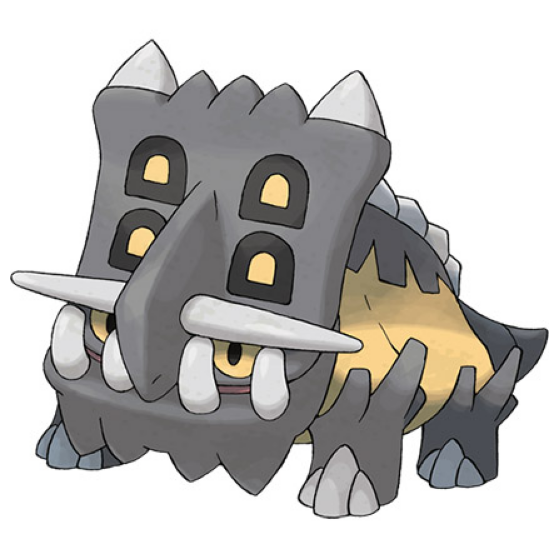

1. The creature is primarily grey with some yellow and black accents.
2. The creature looks unfriendly due to its sharp teeth and the overall aggressive stance it is portrayed with.

### Matched by generated text

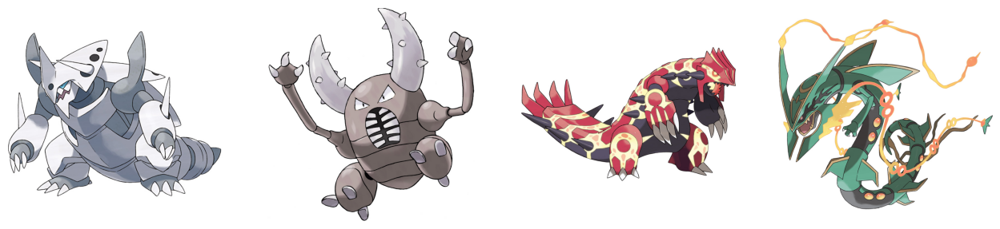

### Matched by raw image

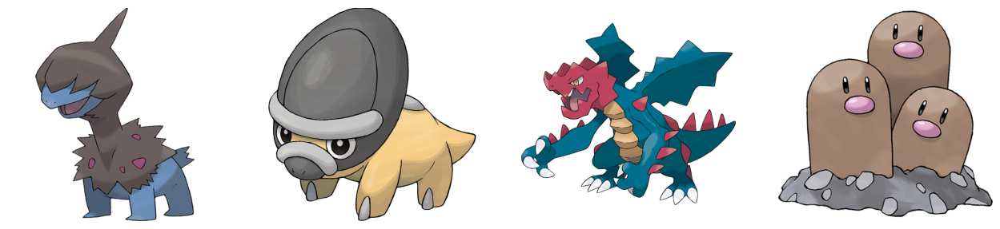

---

---

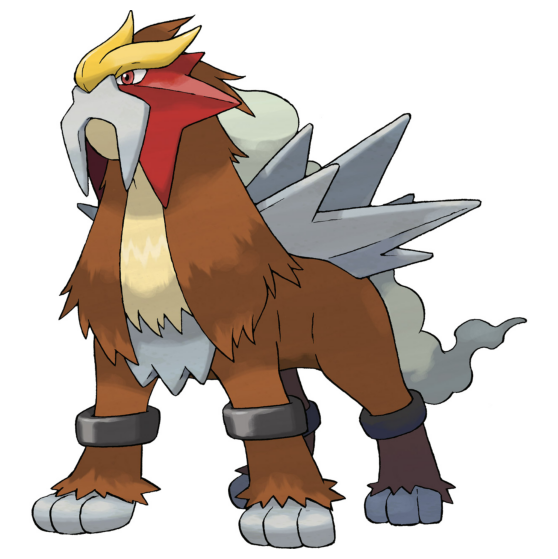

1. The creature is brown and red.
2. The creature looks unfriendly due to its sharp teeth and the aggressive stance it is in.

### Matched by generated text

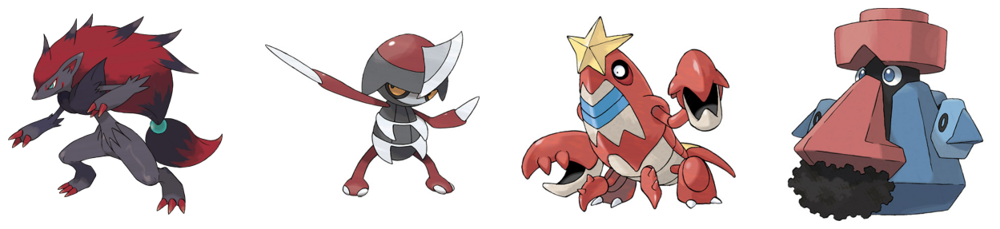

### Matched by raw image

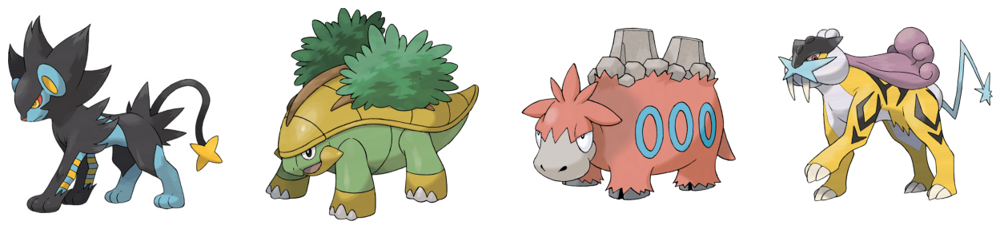

---

---

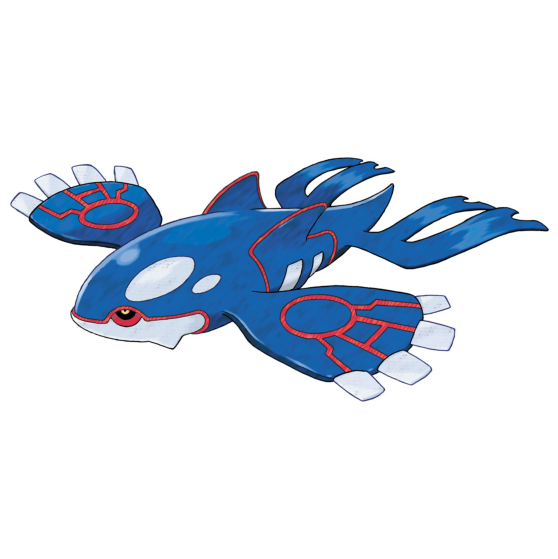

1. The creature is blue.
2. The creature looks friendly. It has a smiling face and a welcoming posture, with its arms outstretched as if to embrace or greet someone.

### Matched by generated text

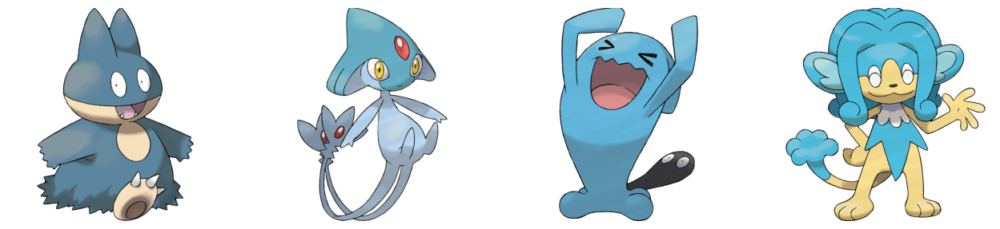

### Matched by raw image

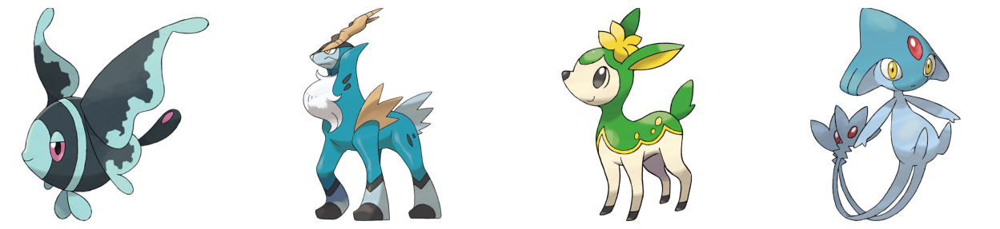

---

---

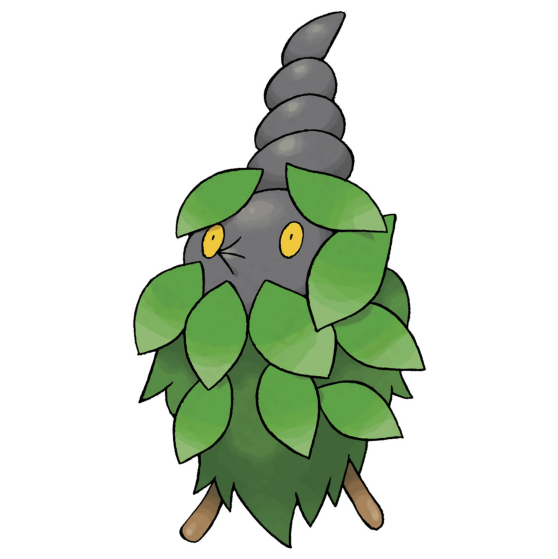

1. The creature is primarily green with some gray and yellow accents.
2. The creature has a somewhat unfriendly appearance due to its large, overgrown leaves and the fact that it is depicted with a frown.

### Matched by generated text

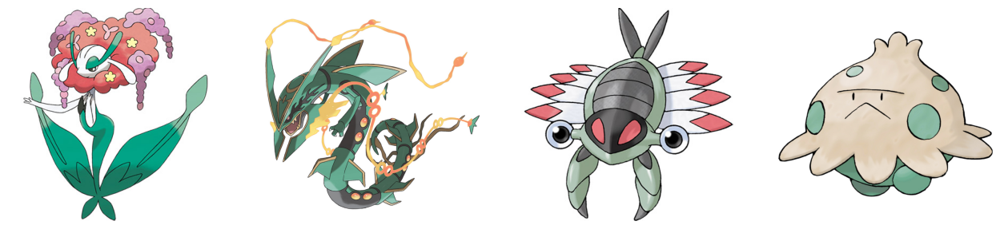

### Matched by raw image

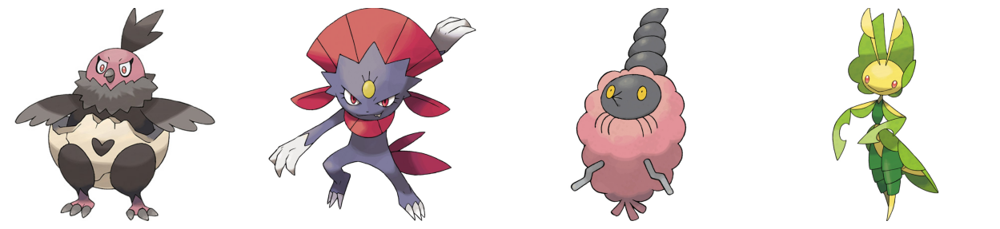

---

---

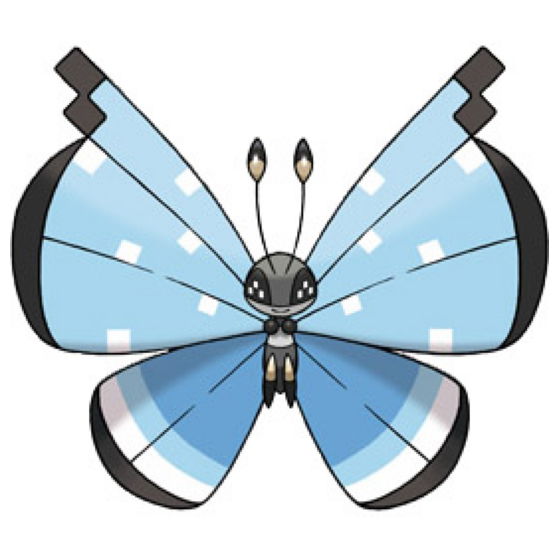

1. The creature is blue with white spots.
2. The creature looks friendly, as it has a smiling expression and is depicted as a cartoon character, which often symbolizes warmth and approachability.

### Matched by generated text

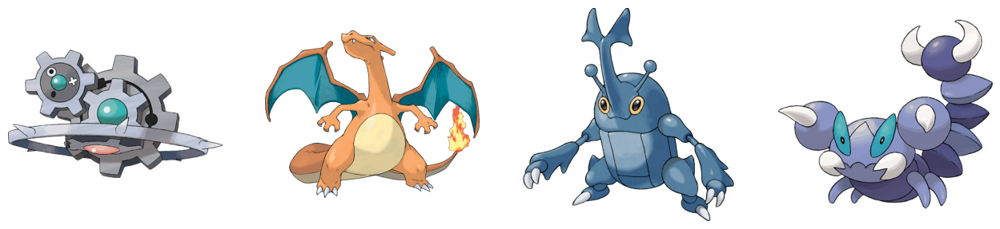

### Matched by raw image

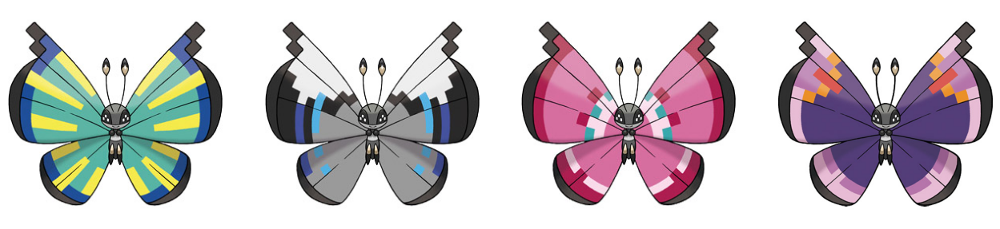

---

---

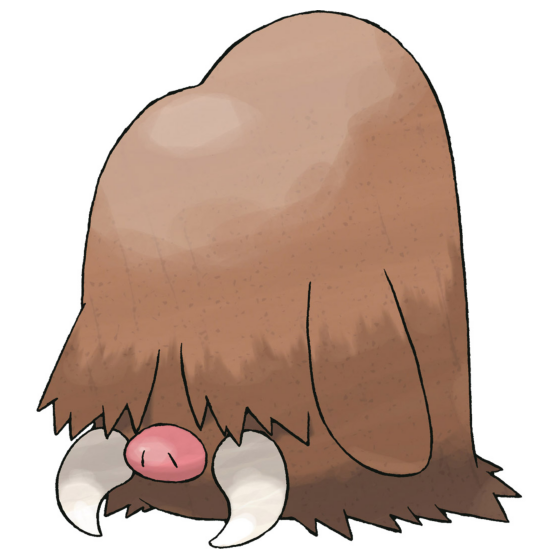

1. The creature is brown.
2. The creature looks unfriendly due to its large size, sharp tusks, and the overall aggressive appearance of its body language.

### Matched by generated text

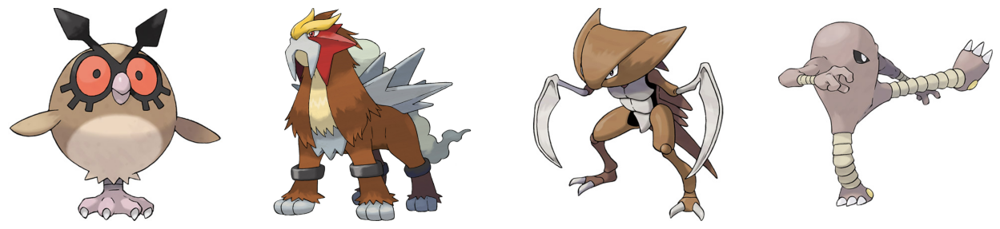

### Matched by raw image

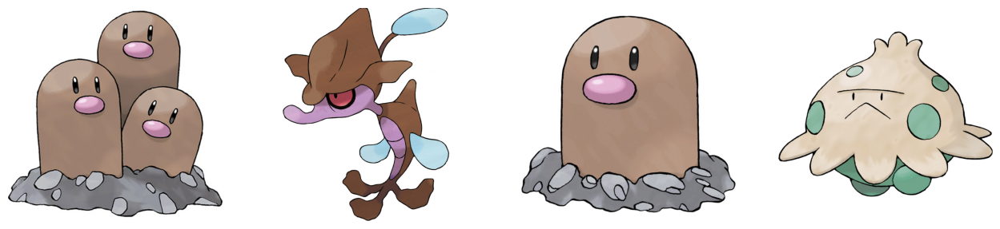

---

---

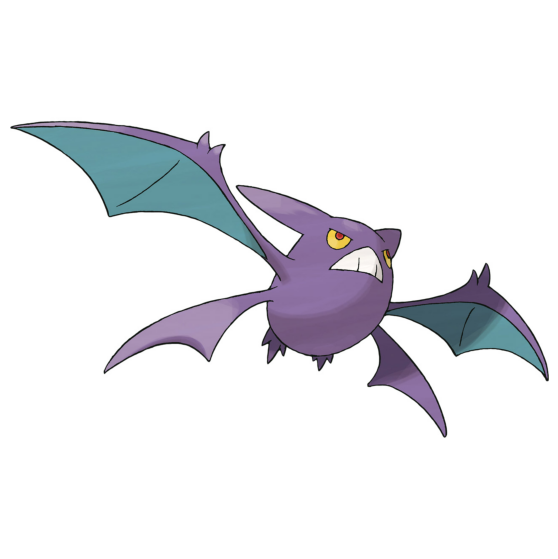

1. The creature is purple.
2. The creature looks unfriendly due to its sharp teeth and the angry expression on its face.

### Matched by generated text

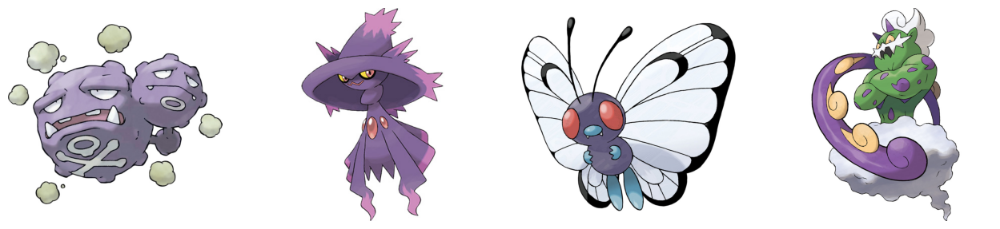

### Matched by raw image

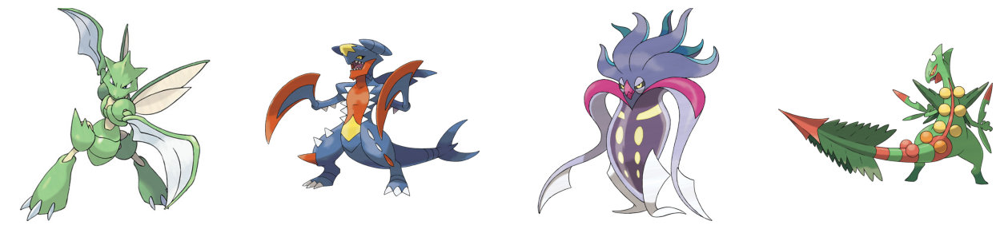

---

---

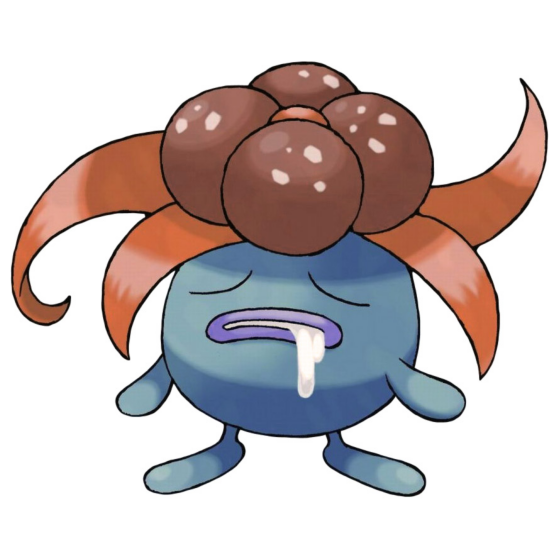

1. The creature is blue.
2. The creature looks unfriendly due to its sad facial expression and the drooping posture of its head, which can be interpreted as a sign of defeat or despair.

### Matched by generated text

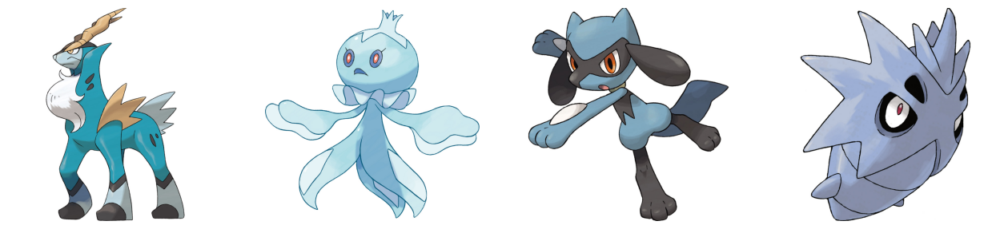

### Matched by raw image

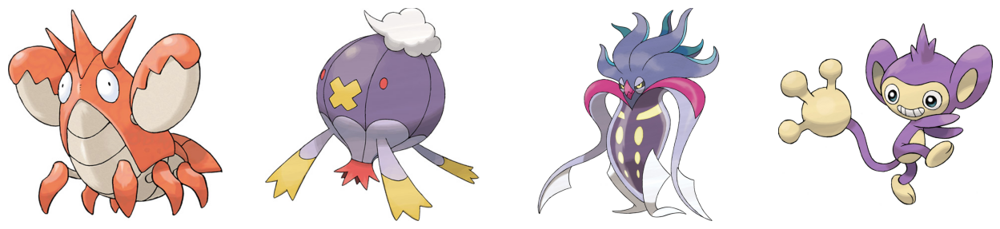

---

---

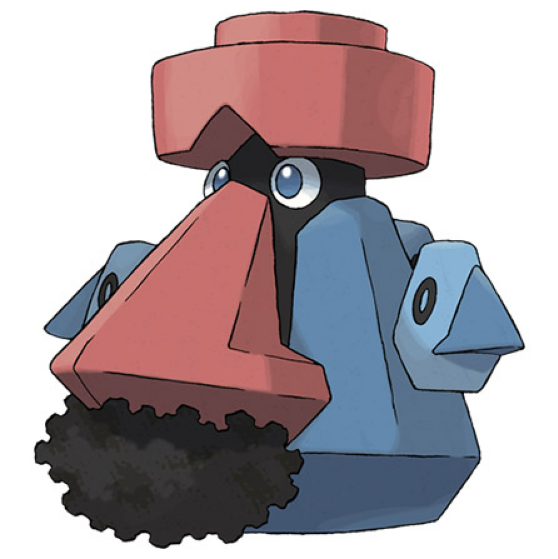

1. The creature is blue and red.
2. The creature looks unfriendly due to its large, sharp teeth and the intense expression on its face.

### Matched by generated text

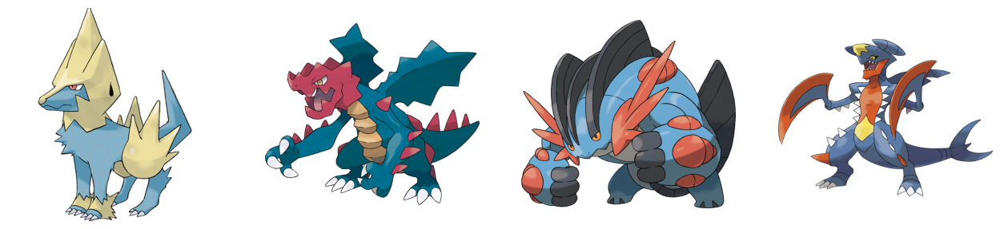

### Matched by raw image

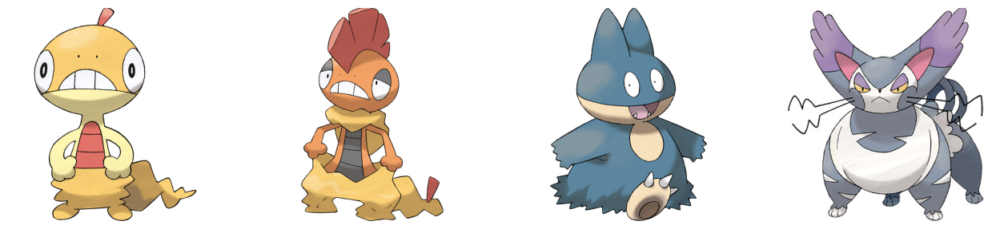

---

---

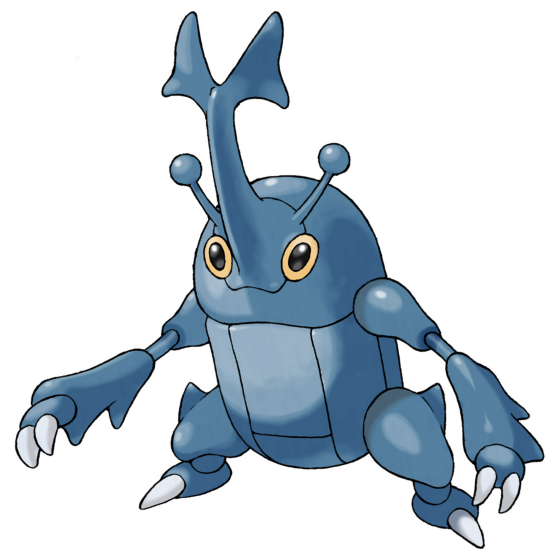

1. The creature is blue.
2. The creature looks friendly. It has a big smile and big eyes, which often indicate a friendly or approachable demeanor in cartoons or illustrations.

### Matched by generated text

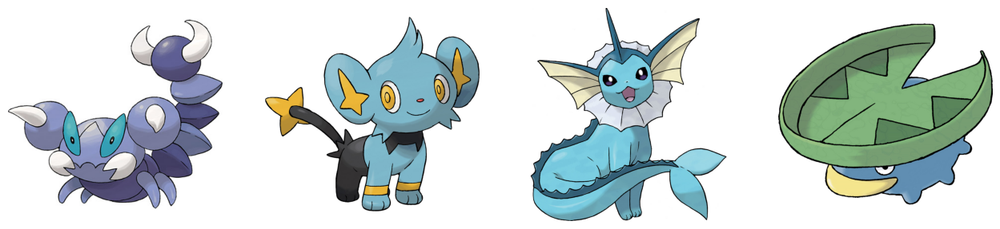

### Matched by raw image

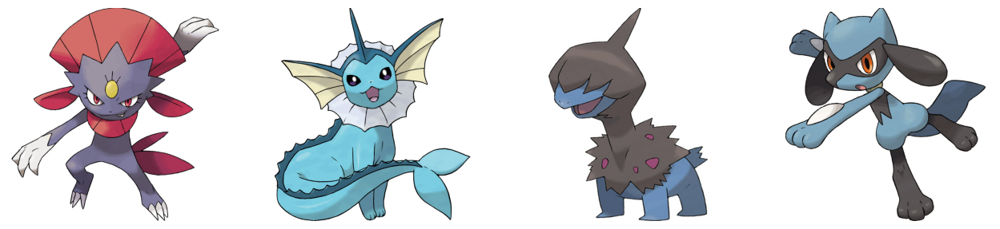

---

---

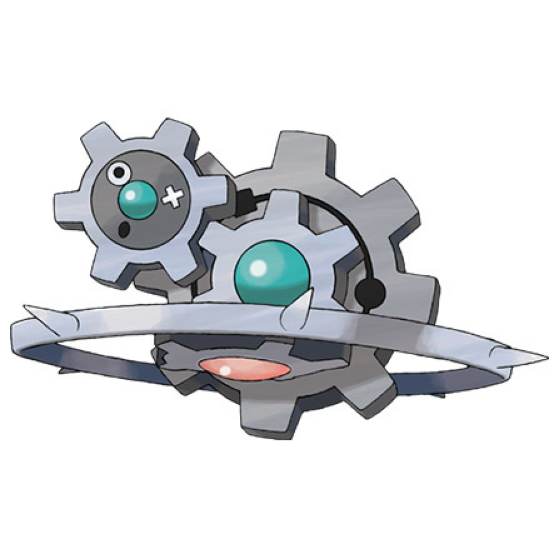

1. The creature is primarily green and white.
2. The creature looks friendly, as it has a smiling expression and is depicted as a cartoon character, which often symbolizes friendliness and approachability.

### Matched by generated text

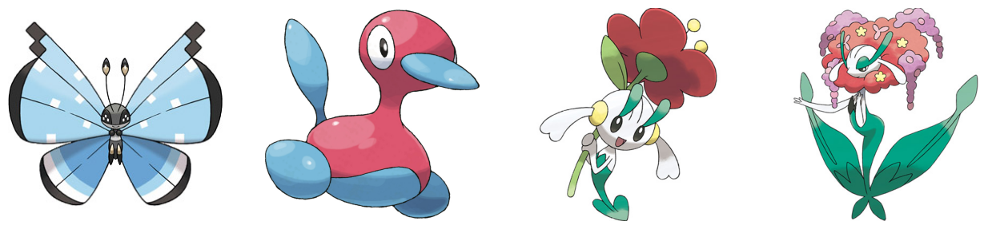

### Matched by raw image

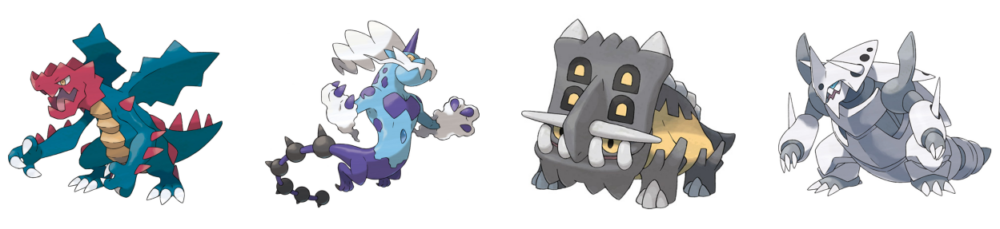

---

---

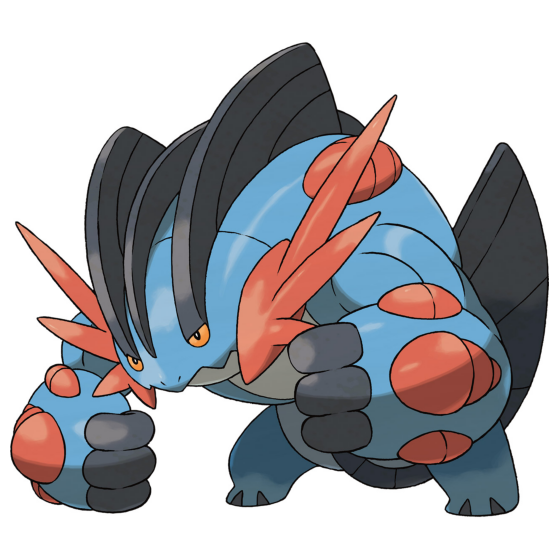

1. The creature is blue with red accents.
2. The creature looks unfriendly due to its large size, sharp claws, and the menacing expression on its face.

### Matched by generated text

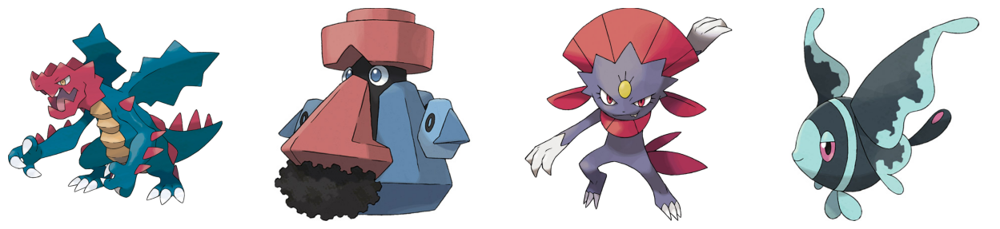

### Matched by raw image

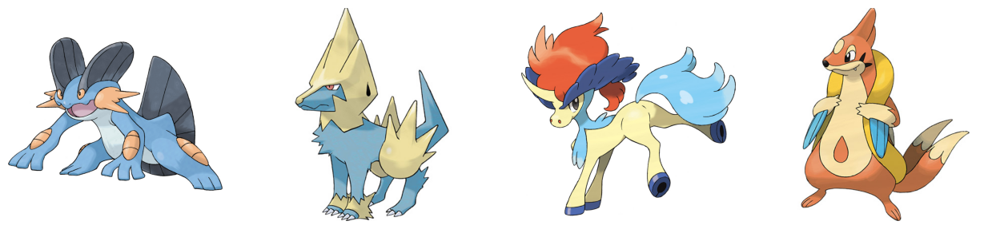

---

---

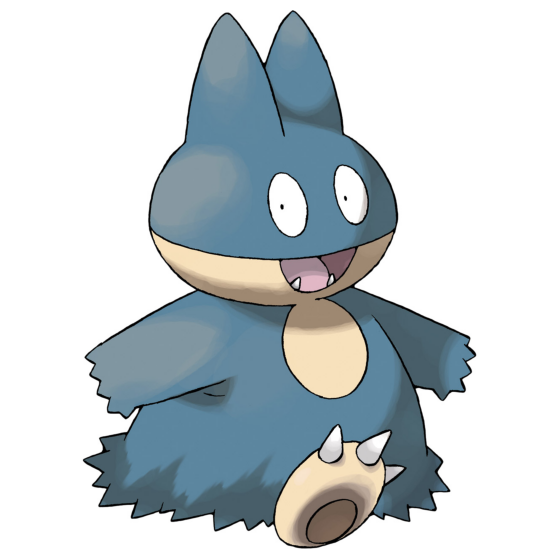

1. The creature is blue.
2. The creature looks friendly. It has a big smile and its body language suggests it is welcoming or happy to see someone.

### Matched by generated text

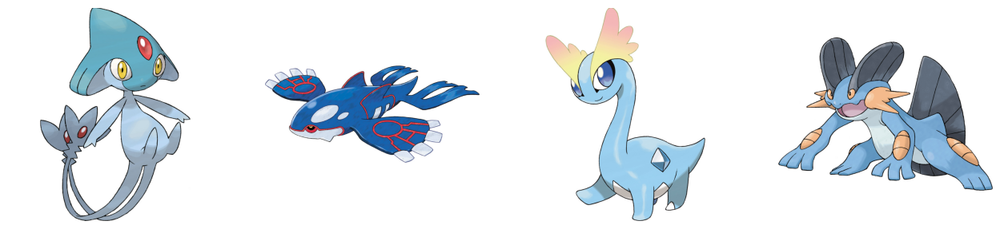

### Matched by raw image

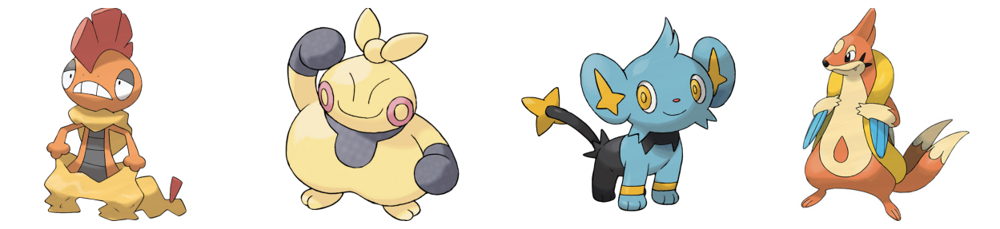

---

---

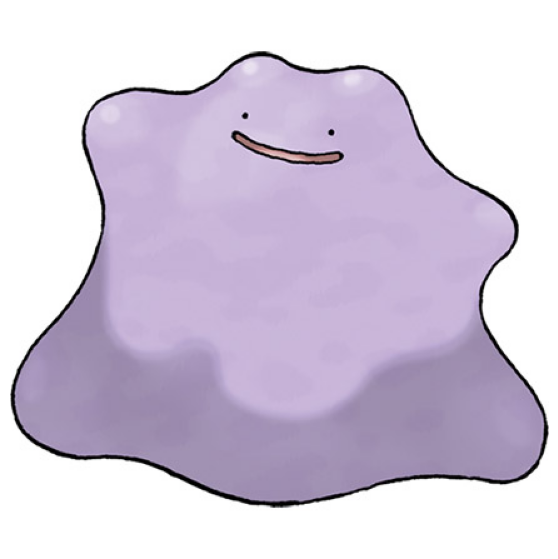

1. The creature is purple.
2. The creature looks friendly. It has a big smile and a relaxed posture, which often indicates a sense of contentment and approachability.

### Matched by generated text

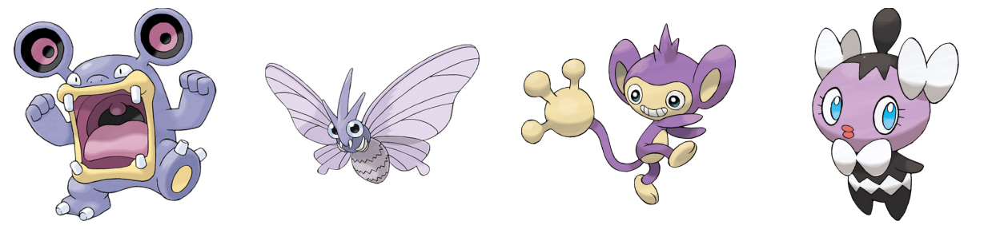

### Matched by raw image

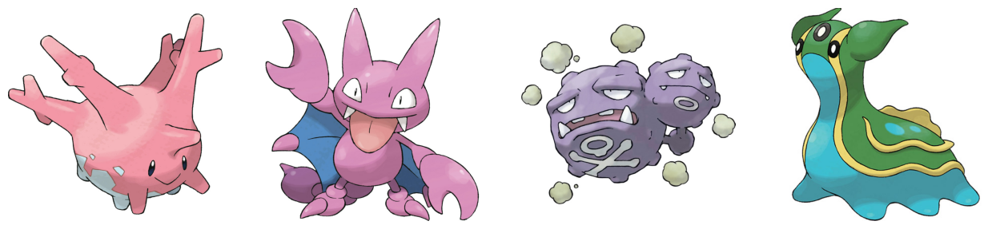

---

---

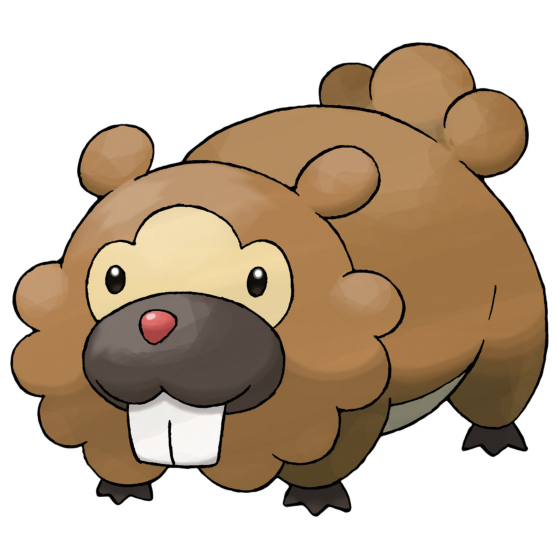

1. The creature is brown.
2. The creature looks friendly. It has a big smile and its body language suggests it is relaxed and comfortable.

### Matched by generated text

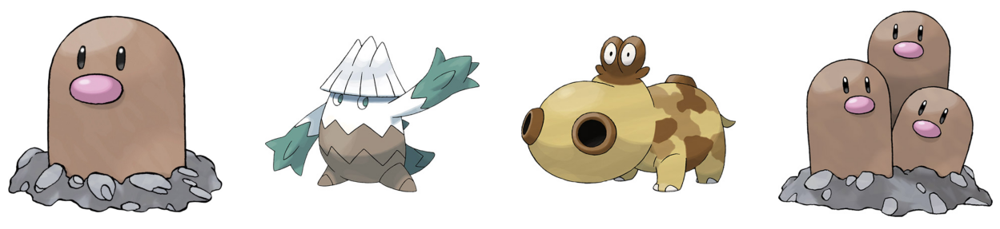

### Matched by raw image

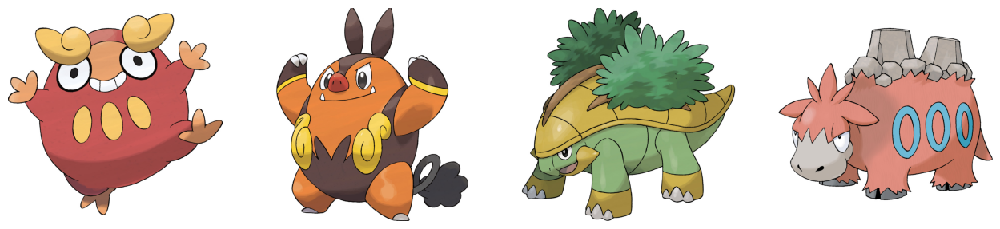

---

---

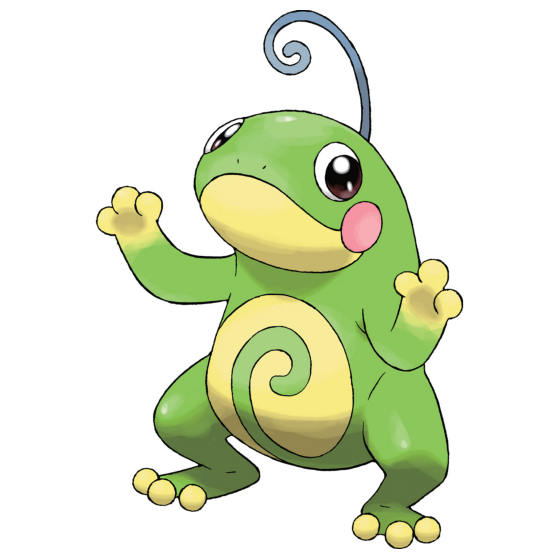

1. The creature is green with yellow and pink accents.
2. The creature looks friendly, with its arms outstretched and a cheerful expression.

### Matched by generated text

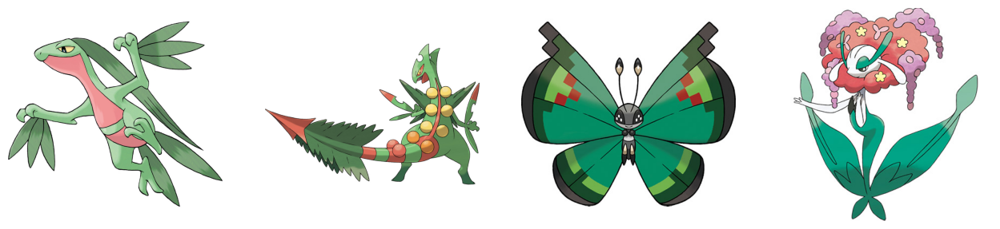

### Matched by raw image

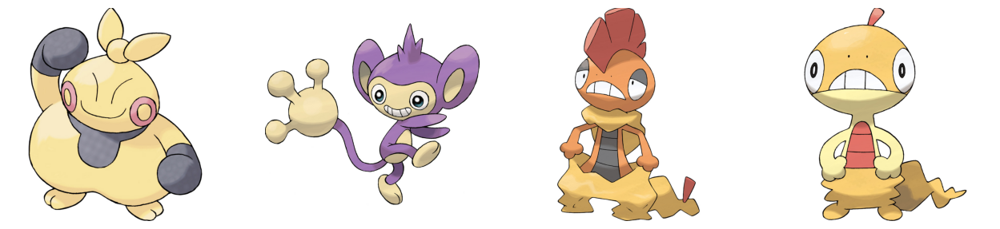

---

---

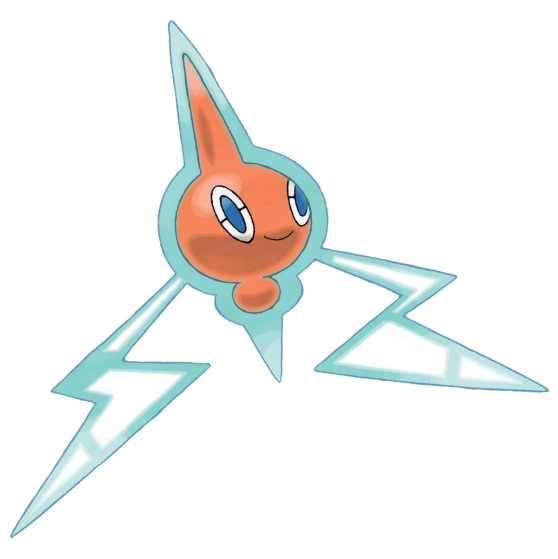

1. The creature is orange.
2. The creature looks friendly. It has a big smile and its body language suggests it is approachable.

### Matched by generated text

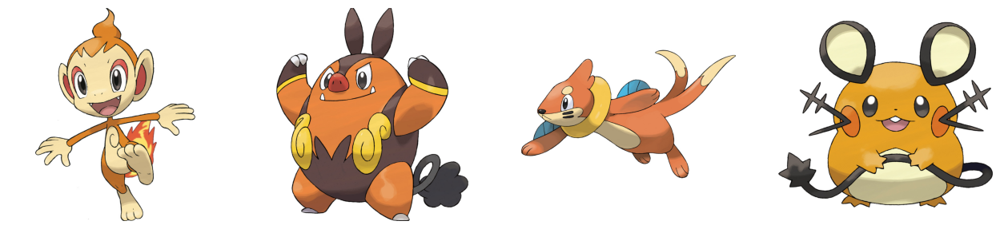

### Matched by raw image

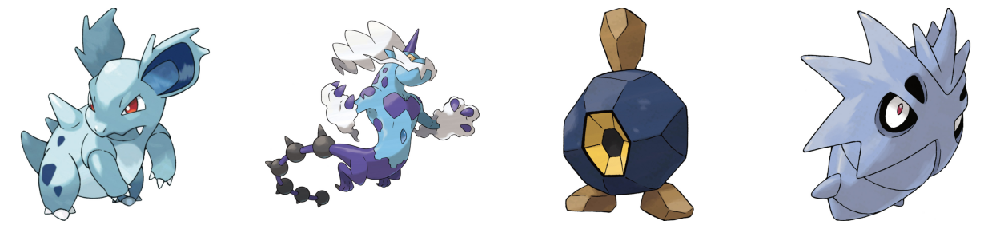

---

---

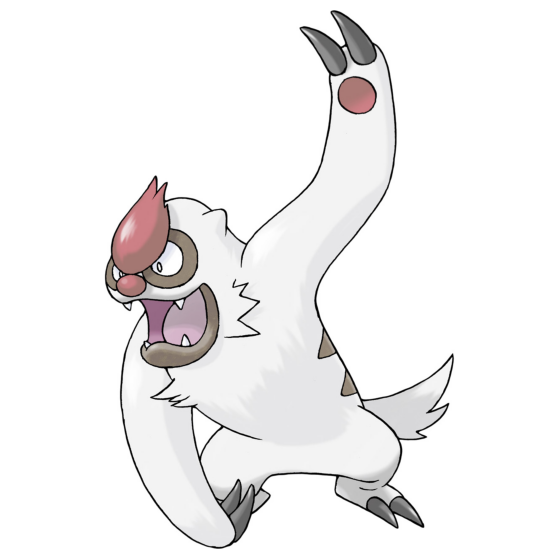

1. The creature is white.
2. The creature looks unfriendly due to its open mouth and the angry expression on its face.

### Matched by generated text

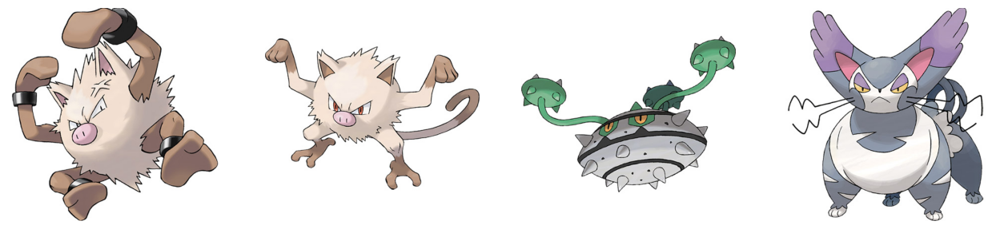

### Matched by raw image

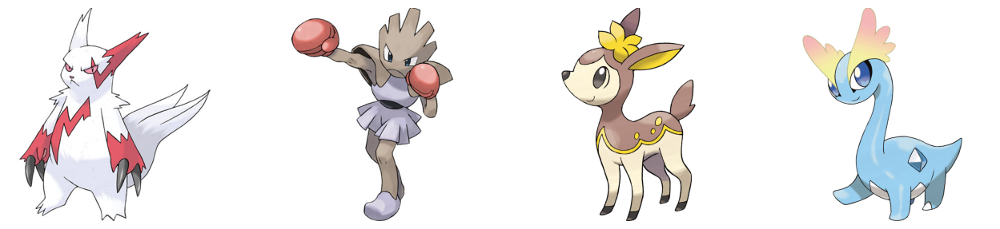

---

---

In [7]:
for text_match_i, image_match_i in zip(text_neighbors, image_neighbors):
    i = text_match_i[0]
    ds_i = int(data.loc[i, 'index'])
    graph.figure(figsize=(7, 7))
    graph.imshow(image_ds['train'][ds_i]['image'])
    graph.axis('off')
    graph.show()
    display(Markdown(data.loc[i, 'response']))

    display(Markdown('### Matched by generated text'))
    graph.figure(figsize=(20, 5))
    for col, j in enumerate(text_match_i[1:]):
        ds_j = int(data.loc[j, 'index'])
        graph.subplot(1, 5, col+1)
        graph.imshow(image_ds['train'][ds_j]['image'])
        graph.axis('off')
    graph.show()

    display(Markdown('### Matched by raw image'))
    graph.figure(figsize=(20, 5))
    for col, j in enumerate(image_match_i[1:]):
        ds_j = int(data.loc[j, 'index'])
        graph.subplot(1, 5, col+1)
        graph.imshow(image_ds['train'][ds_j]['image'])
        graph.axis('off')
    graph.show()

    display(Markdown('---'))
    display(Markdown('---'))